In [1]:
import os
import warnings
import warnings ; warnings.warn = lambda *args,**kwargs: None
import scanpy as sc
import matplotlib.pyplot as plt
import numpy as np
import glob
from pathlib import Path
import infercnvpy as cnv
import genomic_features as gf
import traceback


In [2]:
sc.set_figure_params(frameon=False)

In [3]:
moncada = sc.read_h5ad('/home/aih/shrey.parikh/PDAC/PDAC/inferCNV/Moncada/PDAC_Moncada_inferCNV.h5ad')
peng = sc.read_h5ad('/home/aih/shrey.parikh/PDAC/PDAC/inferCNV/Peng/PDAC_Peng_inferCNV.h5ad')
sclesinger = sc.read_h5ad('/home/aih/shrey.parikh/PDAC/PDAC/inferCNV/Schlesinger/PDAC_Schlesinger_inferCNV.h5ad')
zenodo = sc.read_h5ad('/home/aih/shrey.parikh/PDAC/PDAC/inferCNV/Zenodo_OUGS/PDAC_Zenodo_OUGS_inferCNV.h5ad')
regev = sc.read_h5ad('/home/aih/shrey.parikh/PDAC/PDAC/inferCNV/Regev/PDAC_Regev_inferCNV.h5ad')

In [6]:
datasets = [regev, moncada, peng, sclesinger, zenodo]

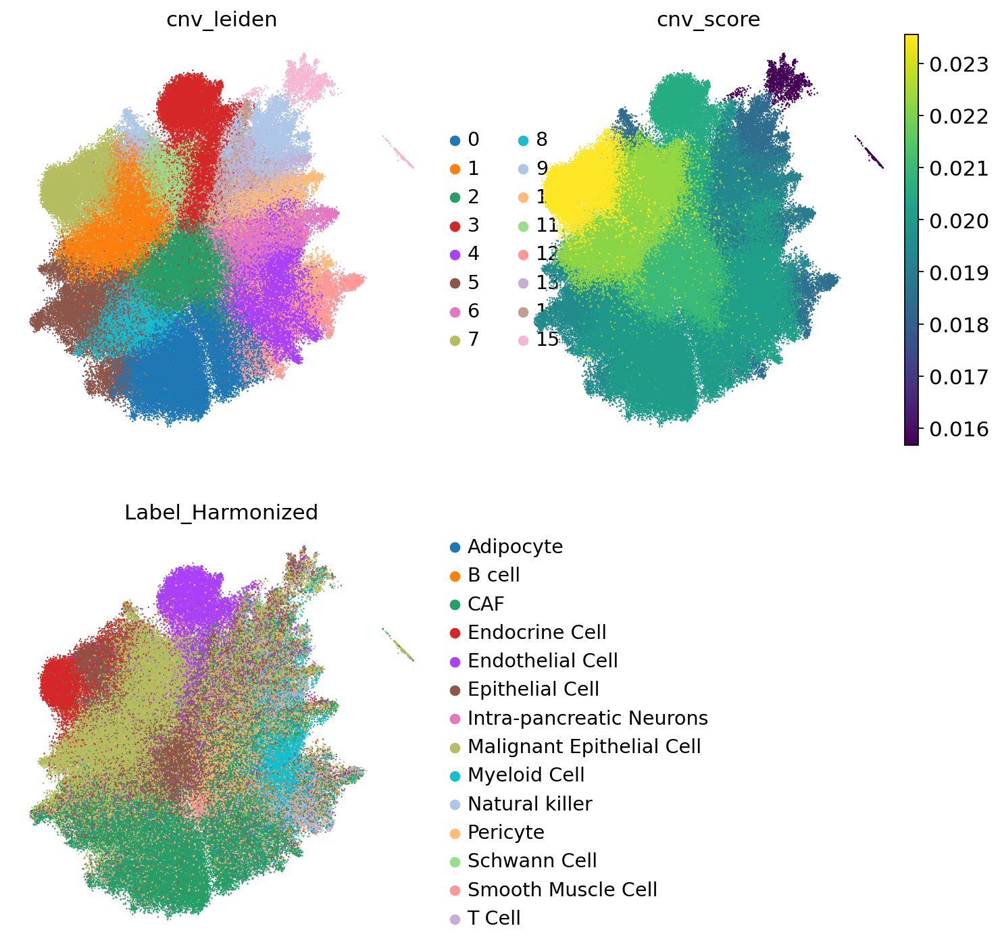

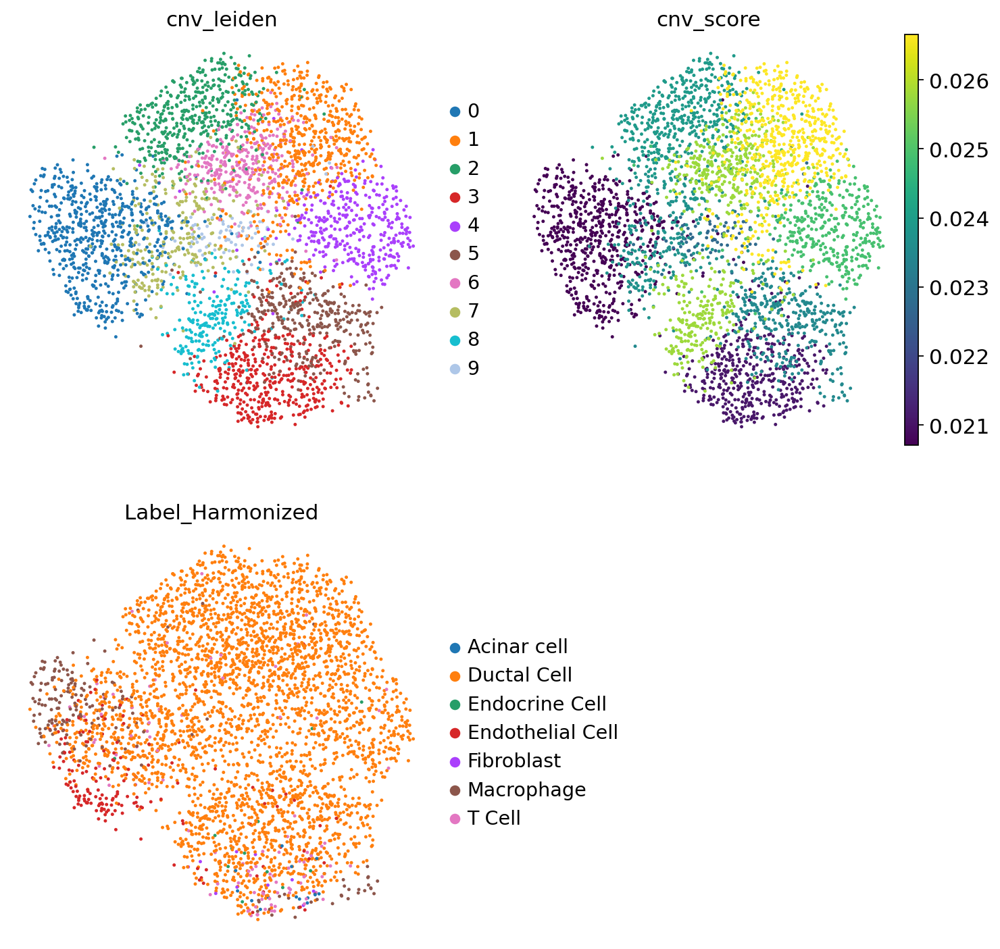

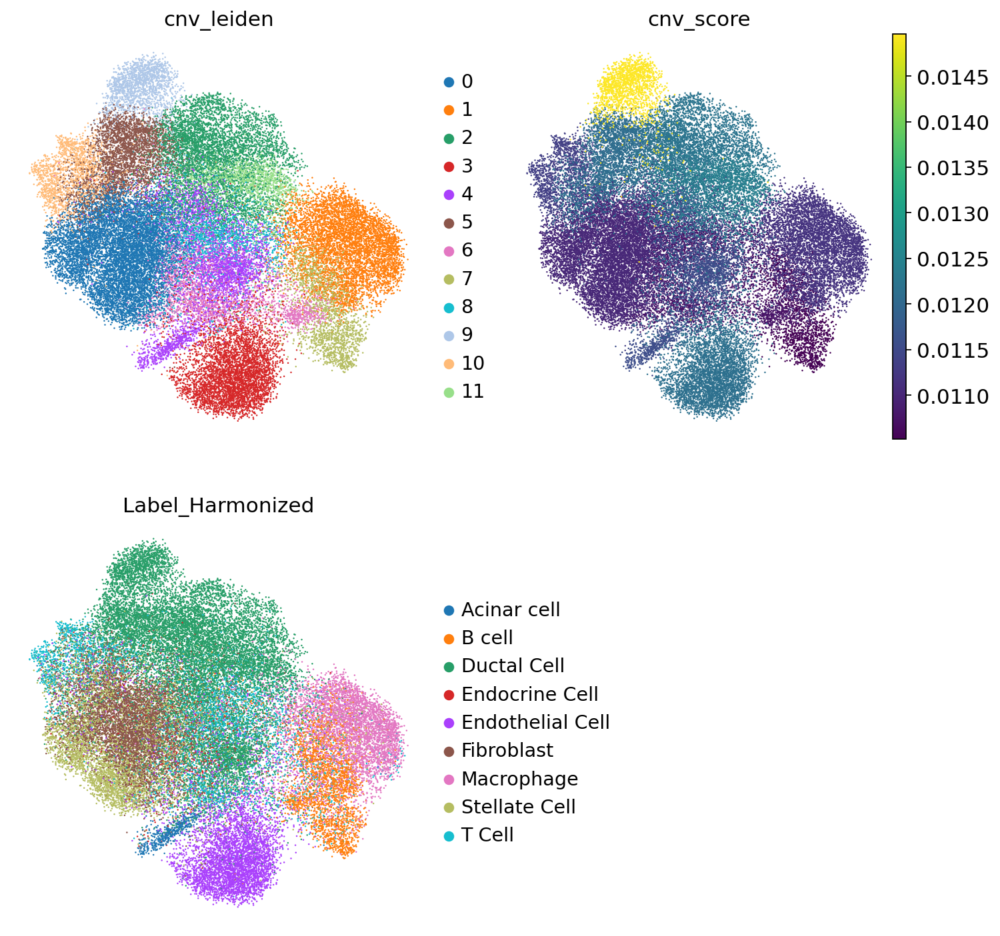

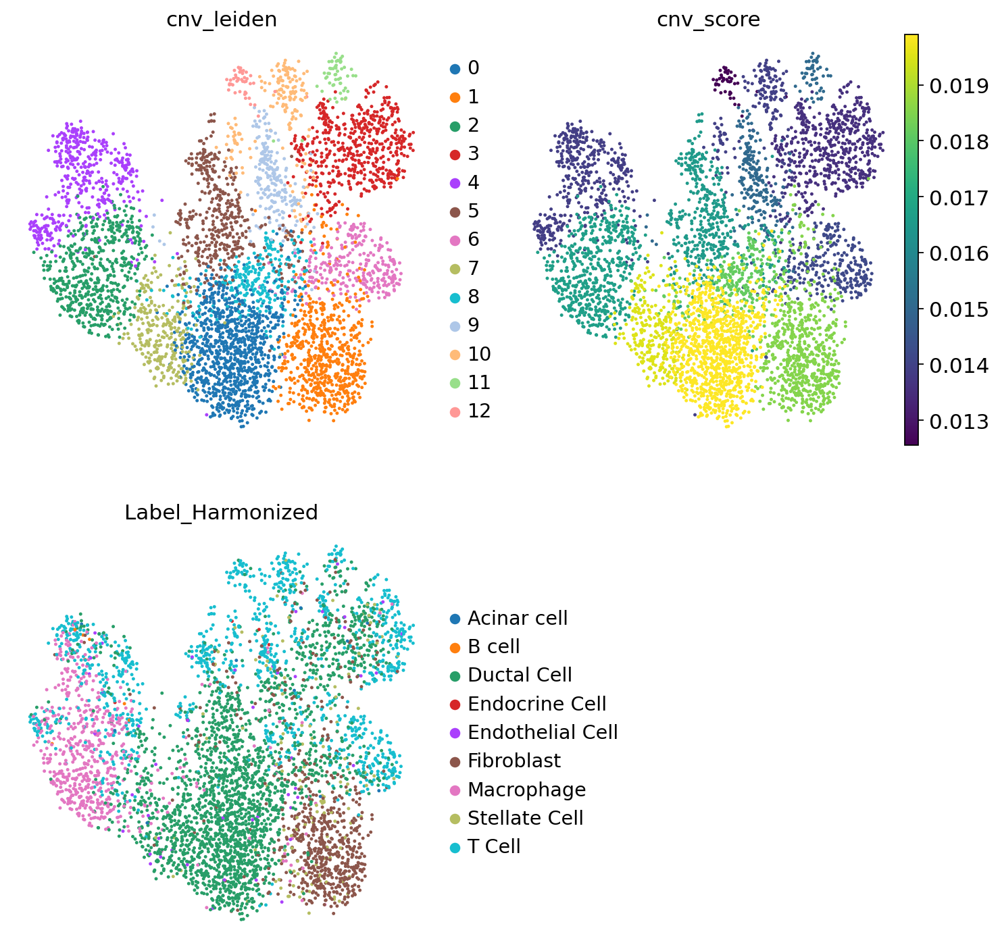

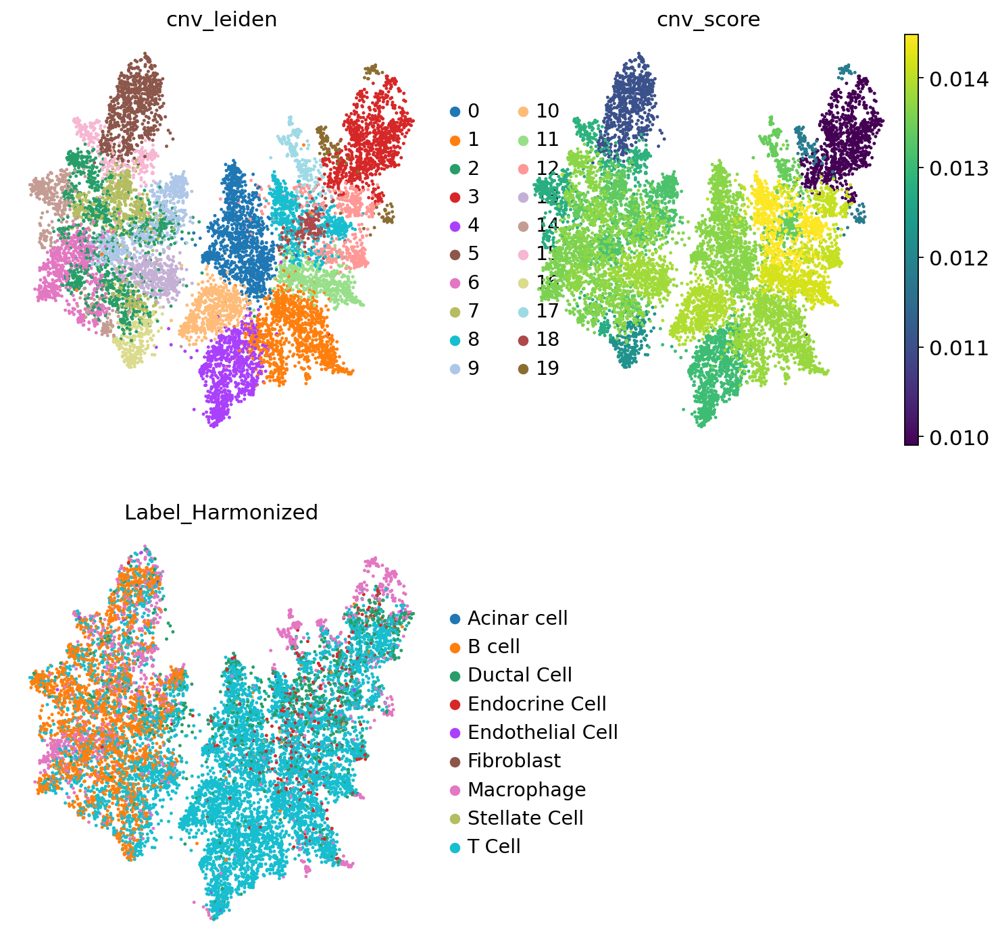

In [18]:
dataset_names = ['regev', 'moncada', 'peng', 'schlesinger', 'zenodo']
for dataset, name in zip(datasets, dataset_names):
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(11, 11))
    ax4.axis("off")
    np.random.seed(0)
    random_indices = np.random.permutation(range(dataset.shape[0]))
    if name in ['moncada', 'schlesinger', 'zenodo']:
        size = 20
    else:
        size = 5

    cnv.pl.umap(dataset[random_indices, :], color="cnv_leiden", ax=ax1, show=False, size=size)
    cnv.pl.umap(dataset[random_indices, :], color="cnv_score", ax=ax2, show=False, size=size)
    cnv.pl.umap(dataset[random_indices, :], color="Label_Harmonized", ax=ax3, size=size)


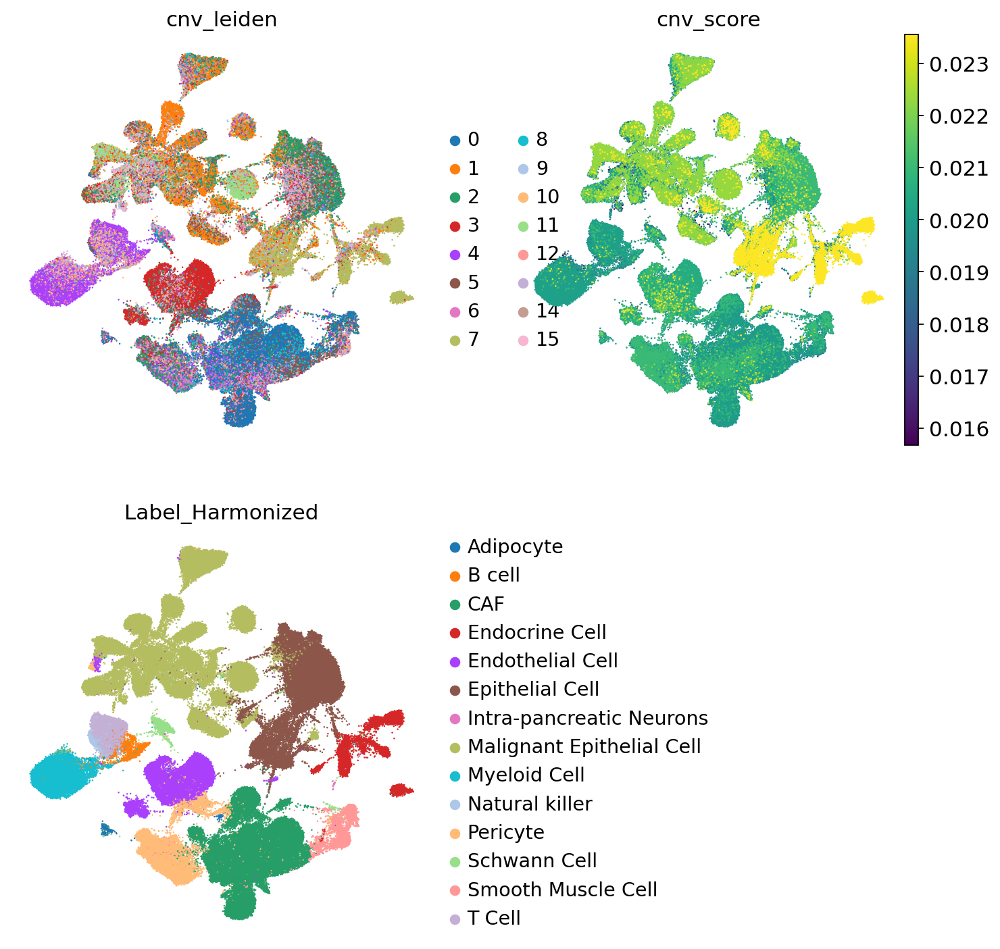

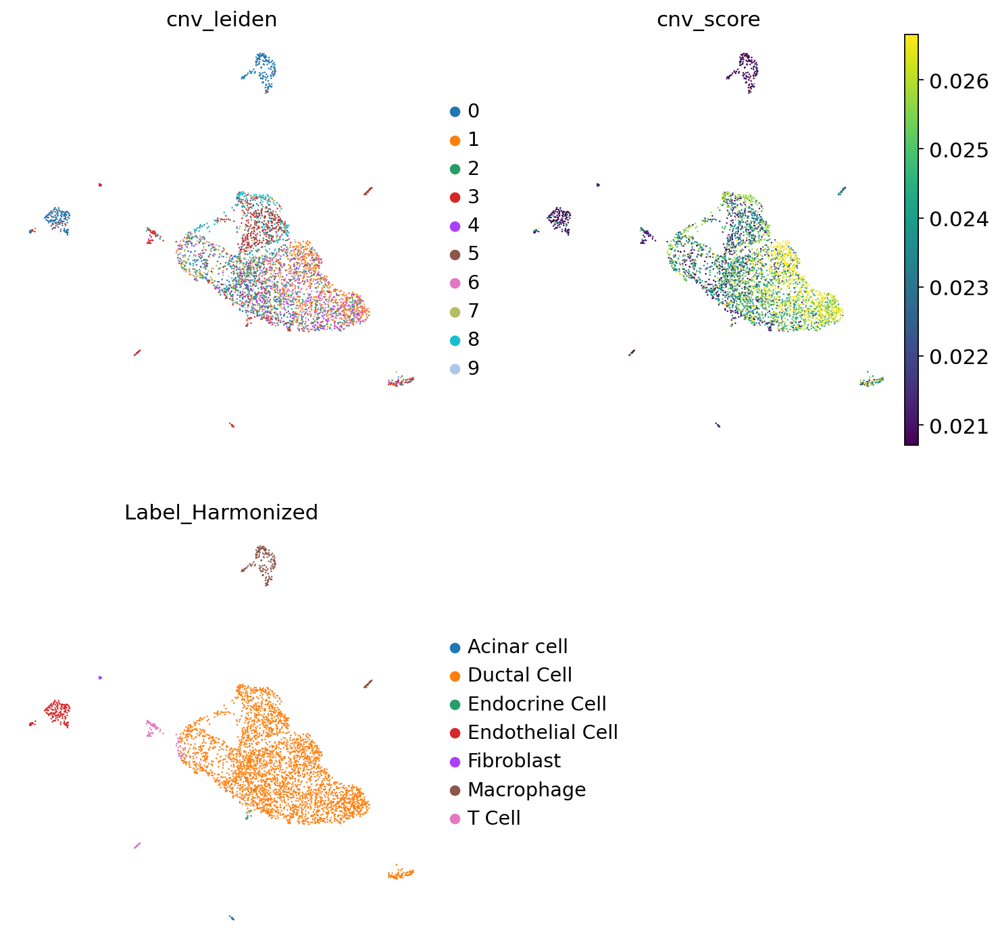

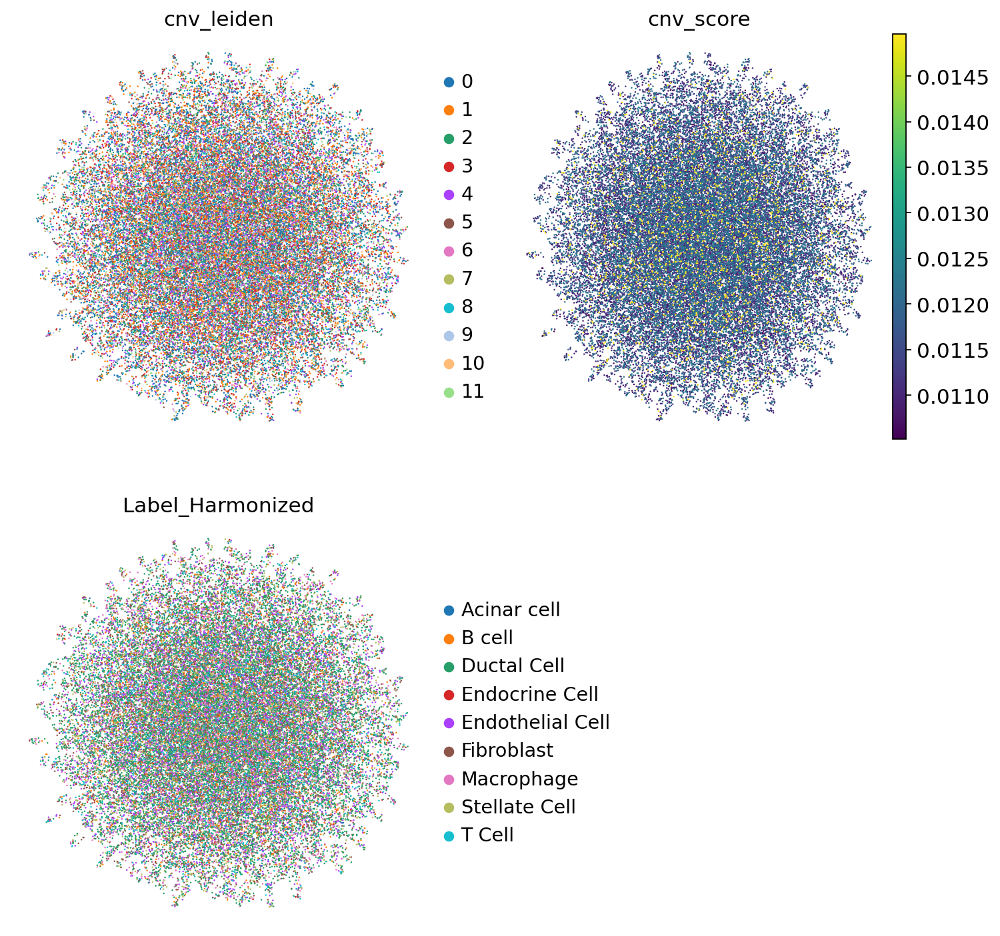

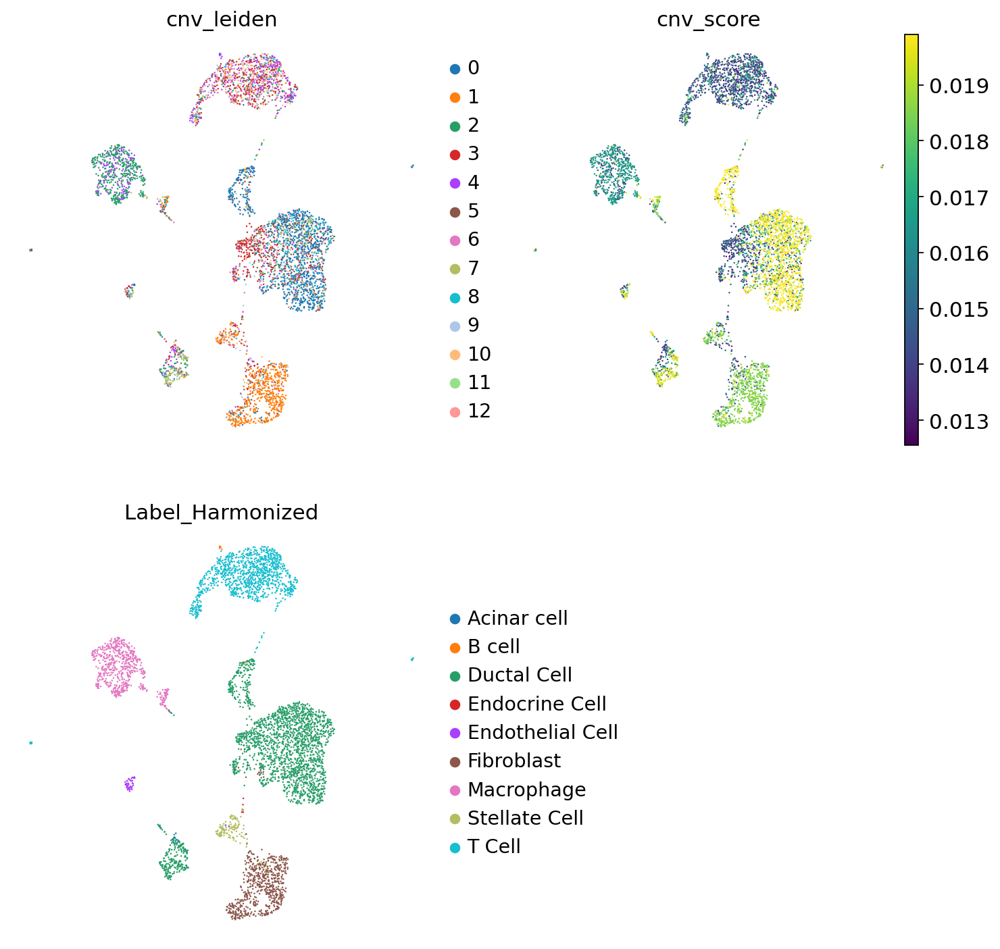

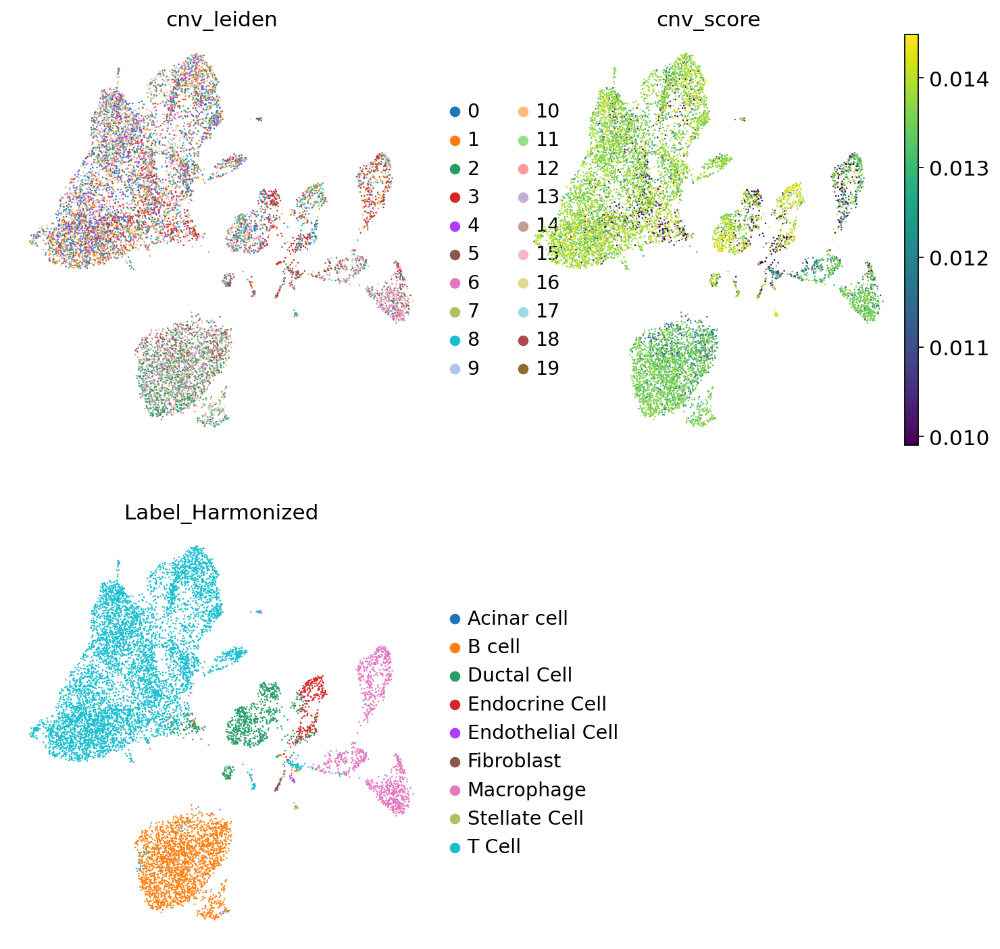

In [21]:
for dataset, name in zip(datasets, dataset_names):
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(11, 11))
    ax4.axis("off")
    np.random.seed(0)
    random_indices = np.random.permutation(range(dataset.shape[0]))
    if name in ['moncada', 'schlesinger', 'zenodo']:
        size = 20
    else:
        size = 5
    sc.pl.umap(dataset[random_indices,:], color="cnv_leiden", ax=ax1, show=False, size=5)
    sc.pl.umap(dataset[random_indices,:], color="cnv_score", ax=ax2, show=False, size=5)
    sc.pl.umap(dataset[random_indices,:], color="Label_Harmonized", ax=ax3, size=5)
    # fig.savefig(f"inferCNV/{dataset}_combined_umap_transcriptomic.png")

In [35]:
peng.X = peng.layers['raw']

In [36]:
sc.pp.normalize_total(peng, target_sum=1e4)
sc.pp.log1p(peng)

In [37]:
sc.pp.neighbors(peng, n_neighbors=30)
sc.tl.umap(peng)

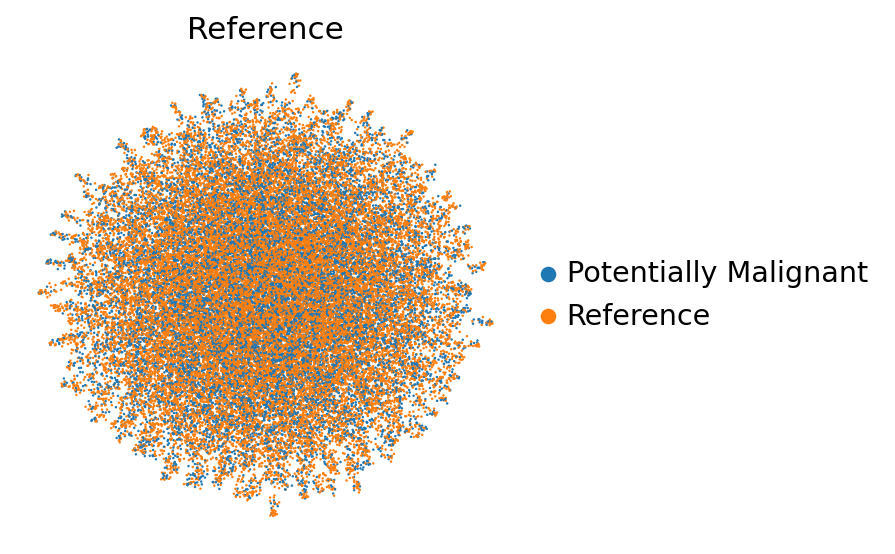

In [38]:
sc.pl.umap(peng, color="Reference", size=5)

In [103]:
peng_raw = sc.read_h5ad('../../processed_datasets/All_genes/Peng_PDAC.h5ad')

In [44]:
sc.pp.neighbors(peng_raw)
sc.tl.umap(peng_raw)

         Falling back to preprocessing with `sc.pp.pca` and default params.


In [52]:
peng_raw.obs = peng_raw.obs.astype(str)

In [56]:
peng_raw.obs

,CELL,CONDITION,Patient,Type,Cell_type,Dataset,ID
T1_AAACCTGAGATGTCGG,T1_AAACCTGAGATGTCGG,T,T1,T,Fibroblast cell,Peng,T1
T1_AAACGGGGTCATGCAT,T1_AAACGGGGTCATGCAT,T,T1,T,Stellate cell,Peng,T1
T1_AAAGATGCATGTTGAC,T1_AAAGATGCATGTTGAC,T,T1,T,Macrophage cell,Peng,T1
T1_AAAGATGGTCGAGTTT,T1_AAAGATGGTCGAGTTT,T,T1,T,Macrophage cell,Peng,T1
T1_AAAGATGGTCTCTCTG,T1_AAAGATGGTCTCTCTG,T,T1,T,Endothelial cell,Peng,T1
...,...,...,...,...,...,...,...
T24_TTTGGTTGTGTTGAGG,T24_TTTGGTTGTGTTGAGG,T,T24,T,Stellate cell,Peng,T24
T24_TTTGGTTTCCAGAGGA,T24_TTTGGTTTCCAGAGGA,T,T24,T,Stellate cell,Peng,T24
T24_TTTGGTTTCCTGCTTG,T24_TTTGGTTTCCTGCTTG,T,T24,T,Ductal cell type 1,Peng,T24
T24_TTTGTCAAGATGTCGG,T24_TTTGTCAAGATGTCGG,T,T24,T,Ductal cell type 2,Peng,T24


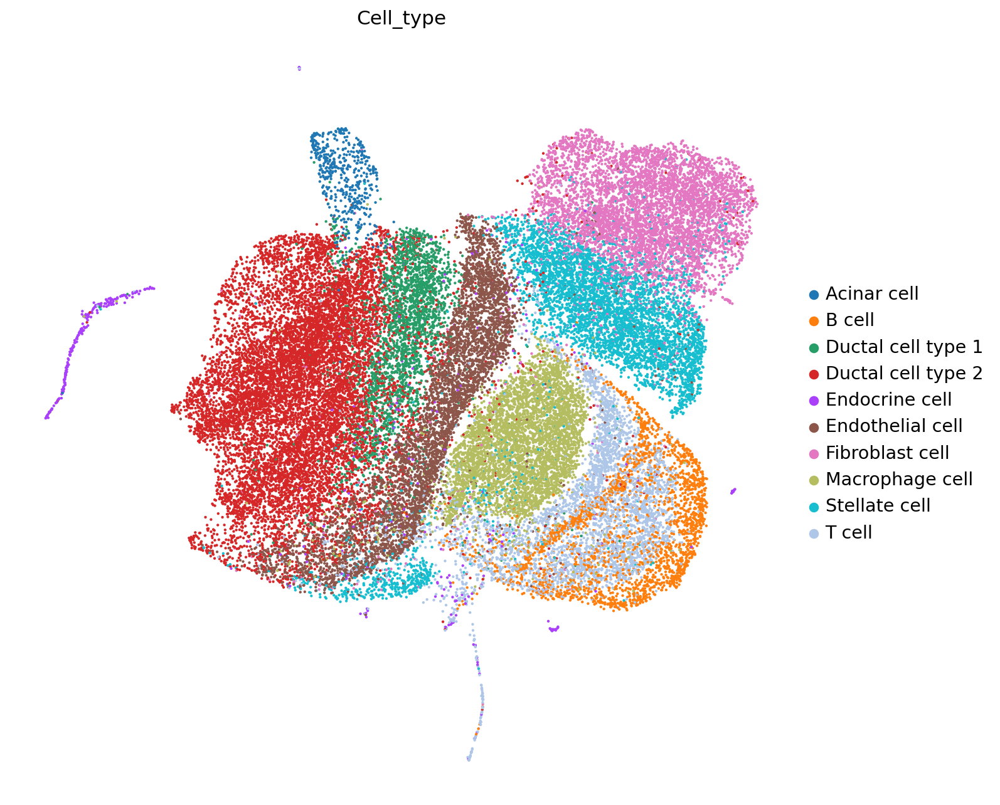

In [57]:
plt.rcParams['figure.figsize'] = [10, 10]   
sc.pl.umap(peng_raw, color="Cell_type", size=15)

In [6]:
# import importlib  # Import the importlib module
# importlib.reload(sc)


In [58]:
ding = sc.read_h5ad("../../processed_datasets/All_genes/Ding_PDAC_annotated.h5ad")

In [62]:
sc.pp.neighbors(ding)
sc.tl.umap(ding)

         Falling back to preprocessing with `sc.pp.pca` and default params.


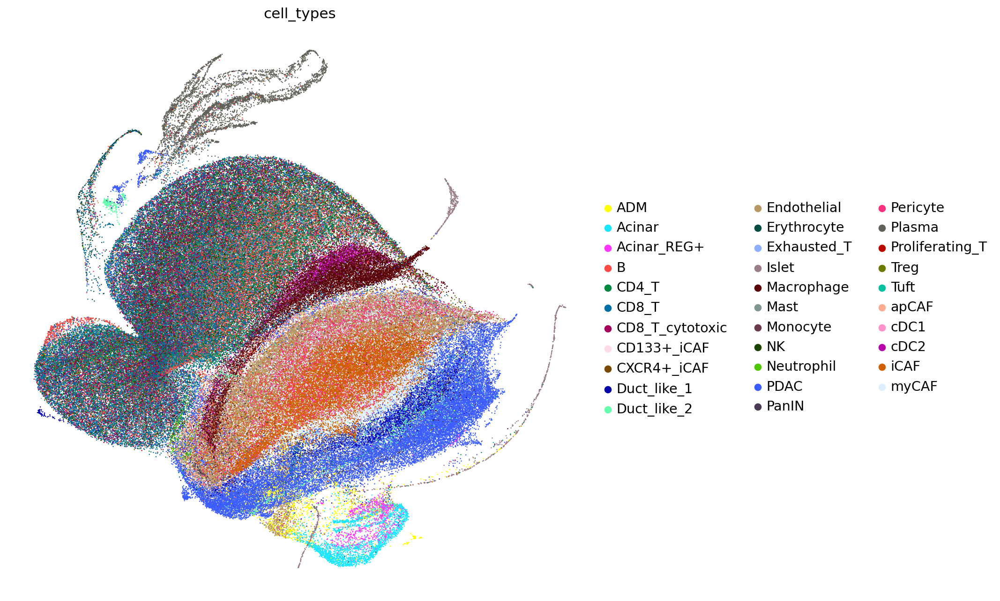

In [64]:
sc.pl.umap(ding, color='cell_types', size=5)

In [66]:
ding.obs.cell_types.unique().tolist()

['Endothelial',
 'myCAF',
 'cDC1',
 'iCAF',
 'Macrophage',
 'CD8_T_cytotoxic',
 'Duct_like_1',
 'CD4_T',
 'Treg',
 'CD8_T',
 'cDC2',
 'NK',
 'Pericyte',
 'CXCR4+_iCAF',
 'Mast',
 'Islet',
 'PDAC',
 'Plasma',
 'Duct_like_2',
 'B',
 'Proliferating_T',
 'CD133+_iCAF',
 'PanIN',
 'Monocyte',
 'Exhausted_T',
 'apCAF',
 'Acinar_REG+',
 'Neutrophil',
 'Acinar',
 'ADM',
 'Erythrocyte',
 'Tuft']

In [ ]:
harmonization = {'Acinar cell':'Acinar cell', 'Adipocyte': 'Adipocyte','Cancer-associated fibroblast': 'CAF','Ductal cell type 1': 'Ductal Cell','Ductal cell type 2': 'Ductal Cell',
    'Endocrine': 'Endocrine Cell','Endocrine cell': 'Endocrine Cell','Endothelial': 'Endothelial Cell','Endothelial cell': 'Endothelial Cell',
    'Epithelial (malignant)': 'Malignant Epithelial Cell','Epithelial (non-malignant)': 'Epithelial Cell','Fibroblast cell': 'Fibroblast',
    'Intra-pancreatic neurons': 'Intra-pancreatic Neurons','Lymphoid': 'Lymphoid Cell','Macrophage cell': 'Macrophage','Myeloid': 'Myeloid Cell','Pericyte': 'Pericyte',
    'Schwann': 'Schwann Cell','Stellate cell': 'Stellate Cell', 'B cell': 'B cell',
    'T cell': 'T Cell','Vascular smooth muscle': 'Smooth Muscle Cell', 'None': 'Uncharacterized'}

In [68]:
regev_raw = sc.read_h5ad("/home/aih/shrey.parikh/PDAC/PDAC/processed_datasets/All_genes/Regev_PDAC.h5ad")

In [86]:
peng_raw.obs.Cell_type.unique().tolist()

['Fibroblast cell',
 'Stellate cell',
 'Macrophage cell',
 'Endothelial cell',
 'T cell',
 'B cell',
 'Ductal cell type 2',
 'Endocrine cell',
 'Ductal cell type 1',
 'Acinar cell']

In [75]:
regev_raw[regev_raw.obs['Level 3 Annotation'] == 'ADM'].obs

,sampleid,n_genes,n_counts,scrublet_scores,pid,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,n_counts_sat,...,new_celltypes,Level 1 Annotation,Level 2 Annotation,Level 3 Annotation,new_treatment,response,log_counts,mt_frac,ID,Dataset
TGAGCATTCACAATGC-1-0,2507,2673,3477.718018,0,T25,2856,7.957527,6308.0,8.749732,1000.0,...,Epithelial-ADM,Epithelial (non-malignant),ADM,ADM,Other,Poor response,8.154132,0.000000,T25,Regev
CTCCTTTAGTTCGGTT-1-0,2507,2403,3348.669678,0,T25,2517,7.831220,5809.0,8.667336,1000.0,...,Epithelial-ADM,Epithelial (non-malignant),ADM,ADM,Other,Poor response,8.116319,0.000000,T25,Regev
ATAGACCGTAGAGTTA-1-0,2507,2361,3327.201416,0,T25,2511,7.828835,5512.0,8.614864,1000.0,...,Epithelial-ADM,Epithelial (non-malignant),ADM,ADM,Other,Poor response,8.109887,0.000311,T25,Regev
GTAGATCTCTAAGCGT-1-0,2507,1849,3098.766357,0,T25,1964,7.583248,3112.0,8.043343,1000.0,...,Epithelial-ADM,Epithelial (non-malignant),ADM,ADM,Other,Poor response,8.038759,0.000000,T25,Regev
TTGTGTTCAAACGTGG-1-0,2507,1568,2843.570801,0,T25,1643,7.404888,2608.0,7.866722,1000.0,...,Epithelial-ADM,Epithelial (non-malignant),ADM,ADM,Other,Poor response,7.952816,0.000000,T25,Regev
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GTGTGATTCATGAAAG-1-45,MGH2076,409,1250.556763,0,T9,438,6.084499,553.0,6.317165,553.0,...,Epithelial-ADM,Epithelial (non-malignant),ADM,ADM,CRT,Minimal response,7.131344,0.000000,T9,Regev
TCGGGTGAGGTCCGAA-1-45,MGH2076,418,1277.268921,0,T9,444,6.098074,549.0,6.309918,549.0,...,Epithelial-ADM,Epithelial (non-malignant),ADM,ADM,CRT,Minimal response,7.152480,0.000000,T9,Regev
AGAACAACATCATTTC-1-45,MGH2076,425,1310.450928,0,T9,450,6.111467,528.0,6.270988,528.0,...,Epithelial-ADM,Epithelial (non-malignant),ADM,ADM,CRT,Minimal response,7.178127,0.000000,T9,Regev
AGTAGCTGTCTTGTCC-1-45,MGH2076,404,1250.702026,0,T9,436,6.079933,522.0,6.259582,522.0,...,Epithelial-ADM,Epithelial (non-malignant),ADM,ADM,CRT,Minimal response,7.131460,0.000000,T9,Regev


In [71]:
regev_raw.obs['Level 1 Annotation'].unique().tolist()

['Endothelial',
 'Epithelial (non-malignant)',
 'Epithelial (malignant)',
 'Cancer-associated fibroblast',
 'Endocrine',
 'Pericyte',
 'Lymphoid',
 'Schwann',
 'Myeloid',
 'Vascular smooth muscle',
 'Adipocyte',
 'Intra-pancreatic neurons']

In [76]:
harmonized_labels = {
    'Endothelial': 'Endothelial Cell',
    'myCAF': 'CAF',
    'cDC1': 'Myeloid Cell',
    'iCAF': 'CAF',
    'Macrophage': 'Macrophage',
    'CD8_T_cytotoxic': 'T Cell',
    'Duct_like_1': 'Ductal Cell',
    'CD4_T': 'T Cell',
    'Treg': 'T Cell',
    'CD8_T': 'T Cell',
    'cDC2': 'Myeloid Cell',
    'NK': 'Natural killer',
    'Pericyte': 'Pericyte',
    'CXCR4+_iCAF': 'CAF',
    'Mast': 'Myeloid Cell', # Assuming Mast as short for Mast cells which are a type of myeloid lineage
    'Islet': 'Endocrine Cell', # Assuming 'Islet' refers to pancreatic islet cells
    'PDAC': 'Malignant Epithelial Cell', # Assuming PDAC stands for Pancreatic Ductal Adenocarcinoma
    'Plasma': 'B cell', # Plasma cells are a type of B cell
    'Duct_like_2': 'Ductal Cell',
    'B': 'B cell',
    'Proliferating_T': 'T Cell',
    'CD133+_iCAF': 'CAF',
    'PanIN': 'Malignant Epithelial Cell', # Assuming PanIN stands for Pancreatic Intraepithelial Neoplasia
    'Monocyte': 'Myeloid Cell',
    'Exhausted_T': 'T Cell',
    'apCAF': 'CAF',
    'Acinar_REG+': 'Acinar cell', # Assuming this refers to some regenerative or special state of Acinar cells
    'Neutrophil': 'Myeloid Cell',
    'Acinar': 'Acinar cell',
    'ADM': 'Epithelial', # ADM could refer to many things; without further context it is uncharacterized
    'Erythrocyte': 'Erythrocyte', # Not specified in the dictionary
    'Tuft': 'Tuft Cell' # Not specified in the dictionary
}


In [79]:
ding.obs['Label_Harmonized'] = ding.obs['cell_types'].map(harmonized_labels)

... storing 'Label_Harmonized' as categorical


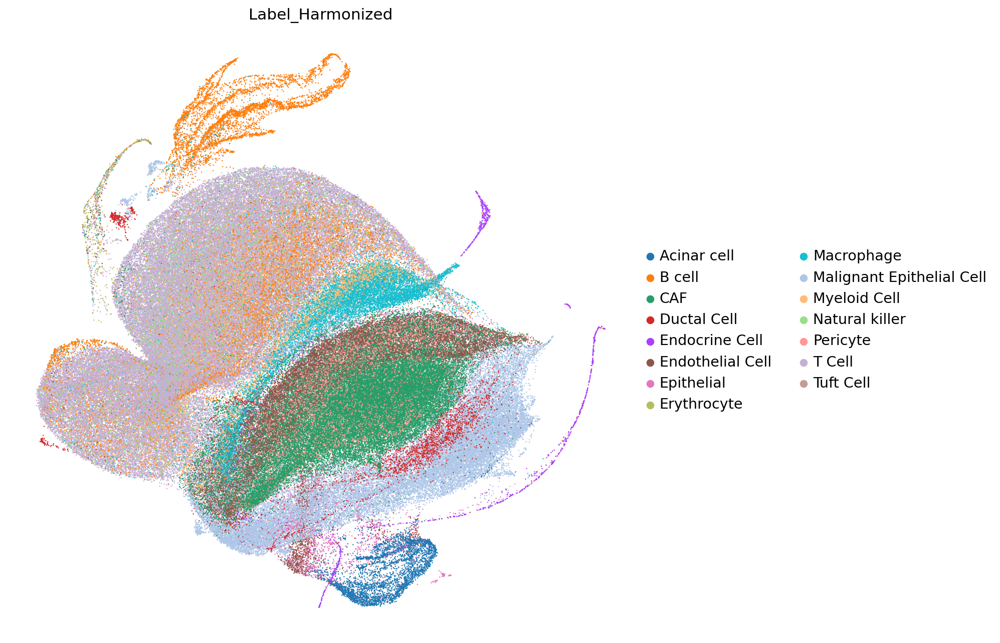

In [81]:
sc.pl.umap(ding, color='Label_Harmonized', size=5)

In [88]:
ding.write('../../processed_datasets/All_genes/Ding_PDAC_annotated.h5ad')

# Using Ding, Regev, Peng, Zenodo

## Using inferCNV on Peng and zenodo for inferCNV to get malignant/non-malignant labels 

## Peng

In [ ]:
peng_raw = sc.read_h5ad('../../processed_datasets/All_genes/Peng_PDAC.h5ad')

In [104]:
peng_raw

AnnData object with n_obs × n_vars = 41964 × 18008
    obs: 'CELL', 'CONDITION', 'Patient', 'Type', 'Cell_type', 'Dataset', 'ID'
    var: 'ENSEMBL', 'SYMBOL'

In [7]:
ensdb = gf.ensembl.annotation(species="Hsapiens", version="108")
genes = ensdb.genes()
dict_map = {gene: (start, end, chrom) for gene, start, end, chrom in zip(genes.gene_name, genes.gene_seq_start, genes.gene_seq_end, genes.seq_name)}

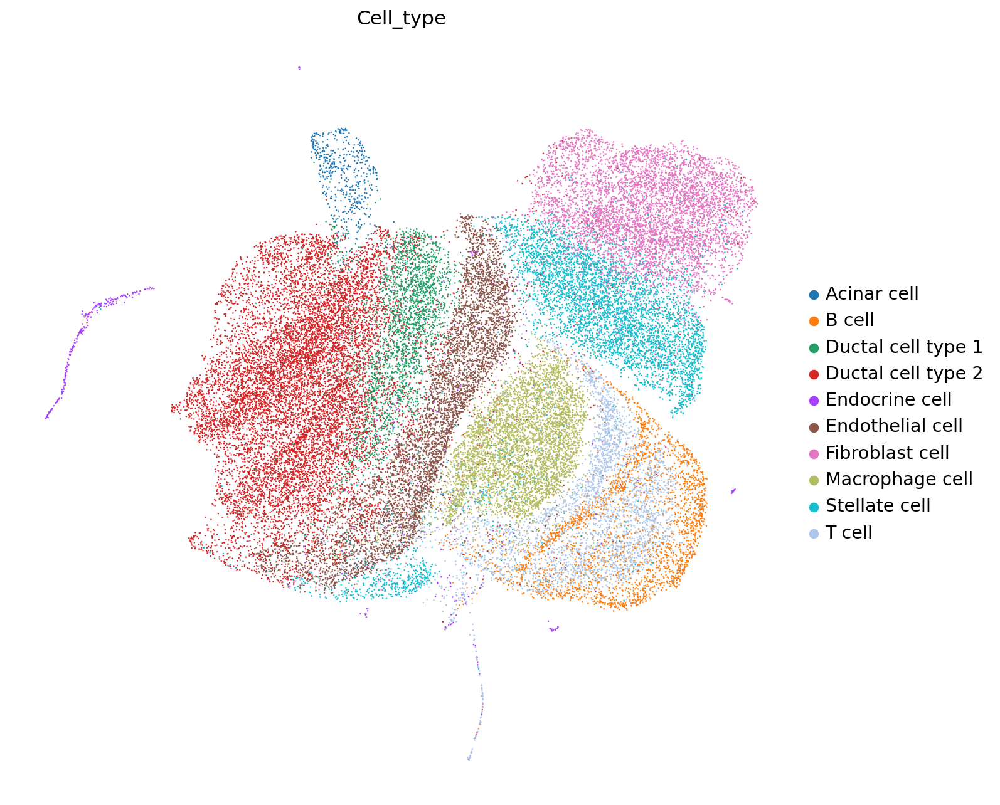

In [99]:
sc.pl.umap(peng_raw, color='Cell_type', size=5)

In [100]:
peng_raw.obs.Cell_type.unique().tolist()

['Fibroblast cell',
 'Stellate cell',
 'Macrophage cell',
 'Endothelial cell',
 'T cell',
 'B cell',
 'Ductal cell type 2',
 'Endocrine cell',
 'Ductal cell type 1',
 'Acinar cell']

         Falling back to preprocessing with `sc.pp.pca` and default params.
infering CNVs


  0%|          | 0/9 [00:00<?, ?it/s]

... storing 'Reference' as categorical


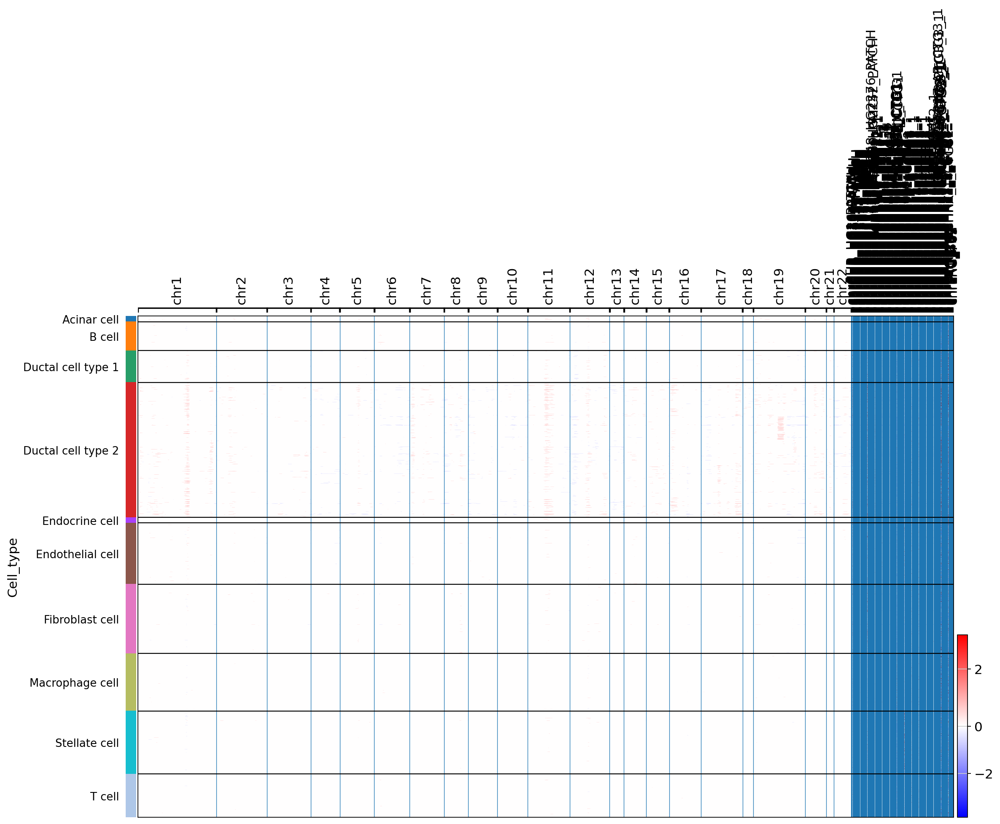

... storing 'Reference' as categorical


         Falling back to preprocessing with `sc.pp.pca` and default params.
categories: 0, 1, 2, etc.
var_group_labels: chr1, chr2, chr3, etc.


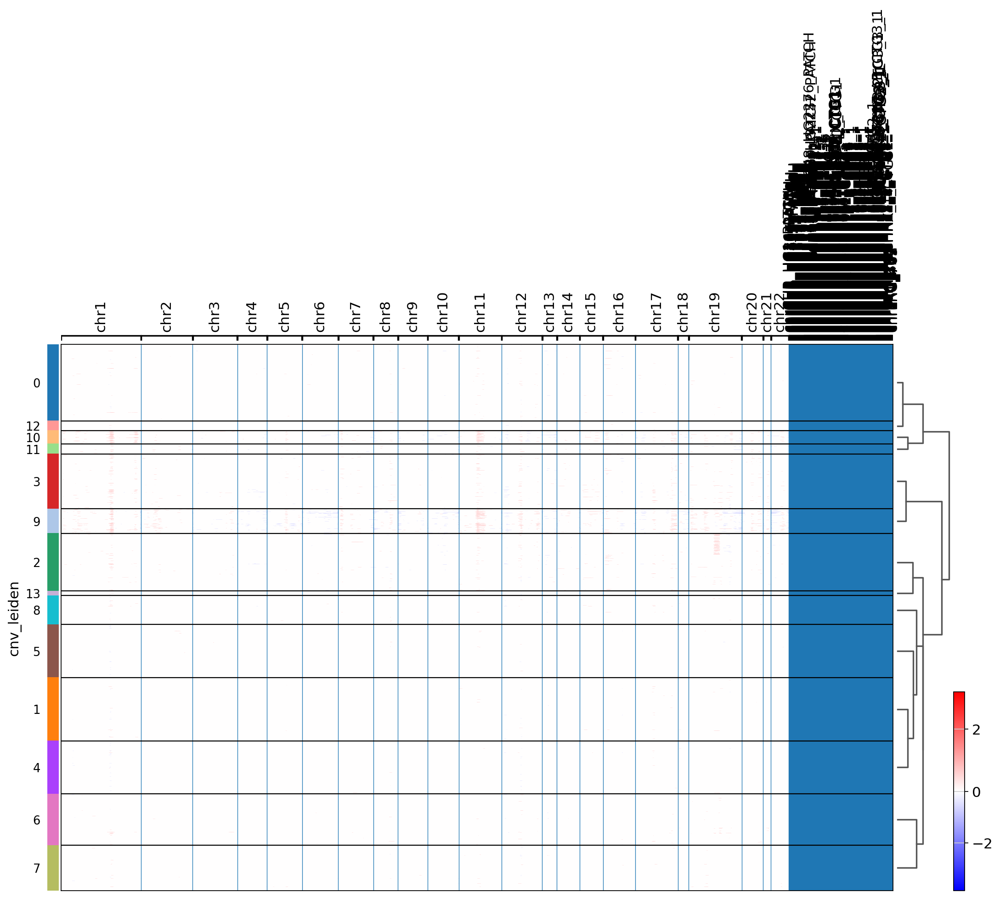

... storing 'Reference' as categorical
... storing 'chromosome' as categorical
... storing 'Reference' as categorical
... storing 'chromosome' as categorical
... storing 'Reference' as categorical
... storing 'chromosome' as categorical


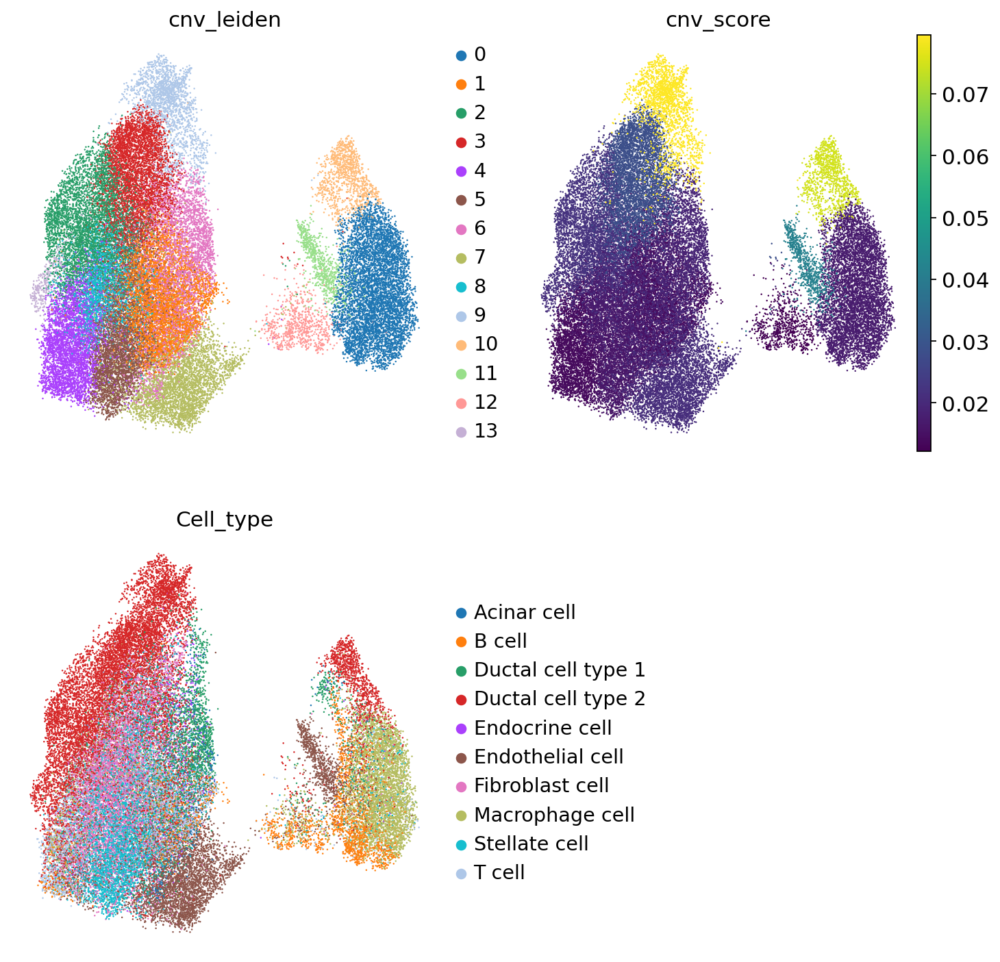

NameError: name 'ref' is not defined

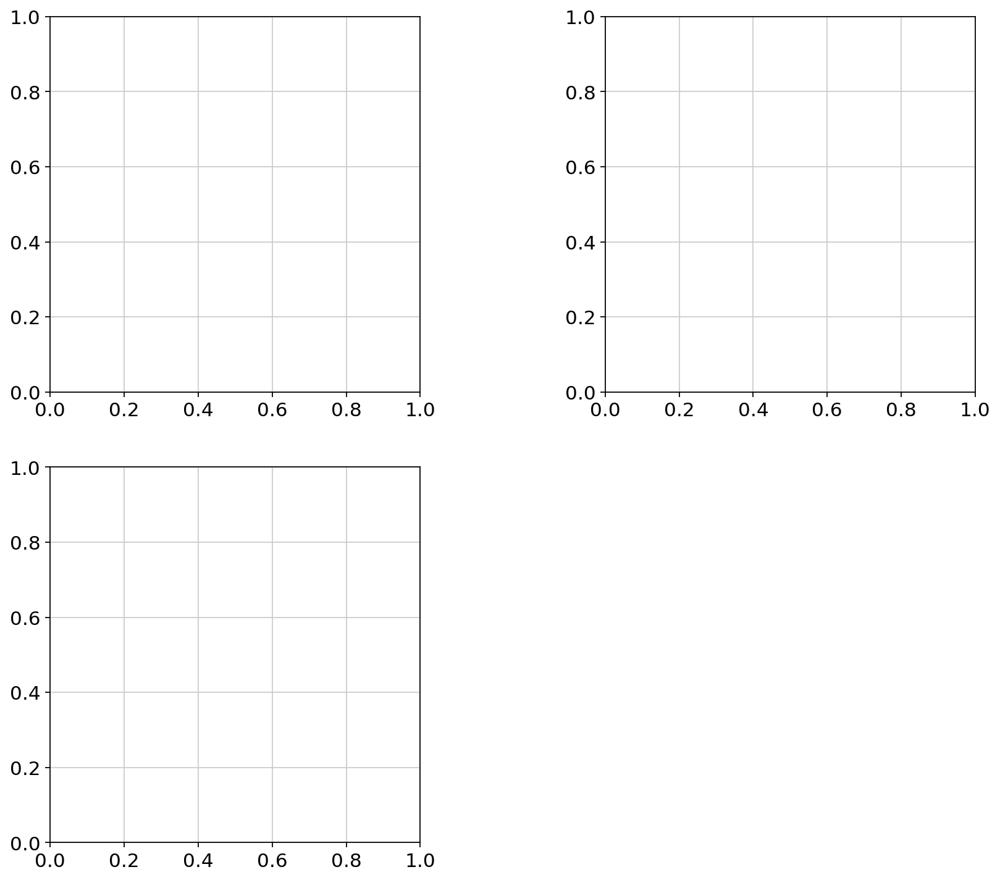

In [107]:
ref_subset = peng_raw.copy()
sc.pp.filter_genes(ref_subset, min_cells=5)
ref_subset.var['start'] = ref_subset.var.index.map(lambda x: dict_map[x][0] if x in dict_map else None)
ref_subset.var['end'] = ref_subset.var.index.map(lambda x: dict_map[x][1] if x in dict_map else None)
ref_subset.var['chromosome'] = ref_subset.var.index.map(lambda x: dict_map[x][2] if x in dict_map else None)
ref_subset.var['chromosome'] = 'chr' + ref_subset.var['chromosome']


malignant_cells = ["Acinar cell", "Ductal cell type 1", "Ductal cell type 2"]
ref_subset.obs["Reference"] = np.where(ref_subset.obs.Cell_type.isin(malignant_cells), 'Potentially Malignant', 'Reference')
#     # Normalize, log transform, and perform dimensionality reduction
# sc.pp.normalize_total(ref_subset, target_sum=1e4)
# sc.pp.log1p(ref_subset)
sc.pp.neighbors(ref_subset)
sc.tl.umap(ref_subset)
sc.tl.leiden(ref_subset)
print(f'infering CNVs')
#     # Run inferCNV
cnv.tl.infercnv(
    ref_subset,
    reference_key="Reference",
    reference_cat="Reference",
    window_size=150,
)

#     # PCA and neighbor graph for CNV data
cnv.tl.pca(ref_subset)
cnv.pp.neighbors(ref_subset)
cnv.tl.leiden(ref_subset)

#     # Run UMAP and CNV scoring
cnv.tl.umap(ref_subset)
cnv.tl.cnv_score(ref_subset)

#     # Save results
# output_dir = f"inferCNV/{dataset}"
# os.makedirs(output_dir, exist_ok=True)
# ref_subset.write(f"{output_dir}/PDAC_{dataset}_inferCNV.h5ad")
# print('Saving Images')
#     # Save chromosome heatmap
cnv.pl.chromosome_heatmap(ref_subset, groupby="Cell_type")
cnv.pl.chromosome_heatmap(ref_subset, groupby="cnv_leiden", dendrogram=True)


... storing 'Reference' as categorical
... storing 'chromosome' as categorical
... storing 'Reference' as categorical
... storing 'chromosome' as categorical
... storing 'Reference' as categorical
... storing 'chromosome' as categorical


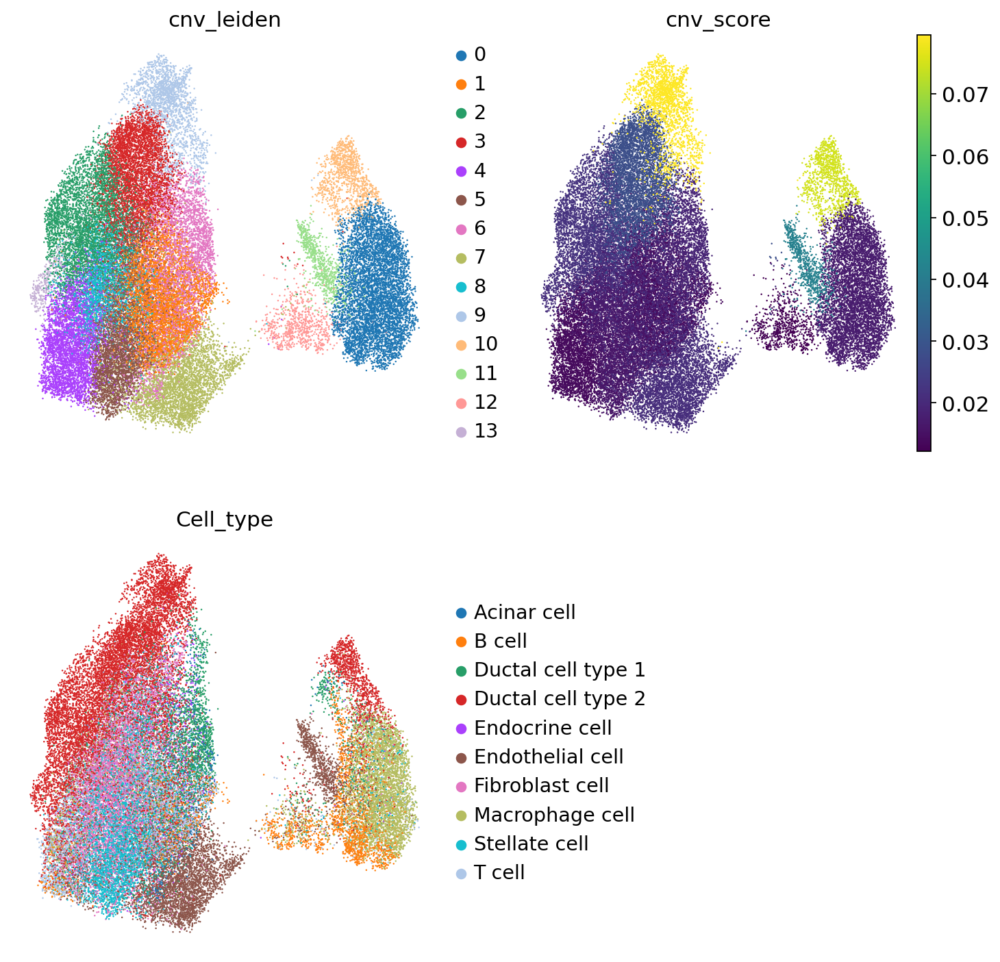

... storing 'Reference' as categorical
... storing 'chromosome' as categorical
... storing 'Reference' as categorical
... storing 'chromosome' as categorical
... storing 'Reference' as categorical
... storing 'chromosome' as categorical


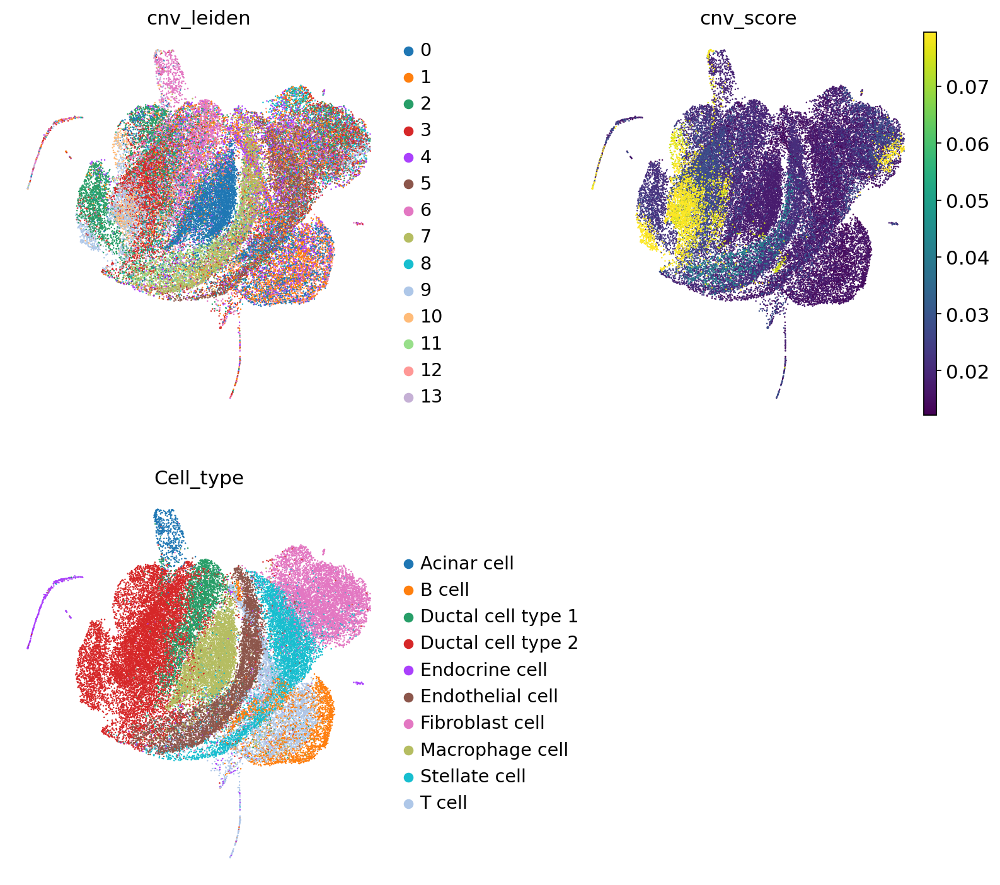

Completed inferring CNVs


In [109]:

#     # Save combined UMAP plots
try:
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(11, 11))
    ax4.axis("off")
    np.random.seed(0)
    random_indices = np.random.permutation(range(ref_subset.shape[0]))
    cnv.pl.umap(ref_subset[random_indices,:], color="cnv_leiden", ax=ax1, show=False, size=5)
    cnv.pl.umap(ref_subset[random_indices,:], color="cnv_score", ax=ax2, show=False, size=5)
    cnv.pl.umap(ref_subset[random_indices,:], color="Cell_type", ax=ax3, size=5)
    plt.close(fig) 
    # fig.savefig(f"{dataset}_combined_umap.png")
except Exception as e:
    print(f"An error occurred while saving UMAP plots for {e}")

fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(12, 11), gridspec_kw={"wspace": 0.5})
ax4.axis("off")
np.random.seed(0)
random_indices = np.random.permutation(list(range(ref_subset.shape[0])))
sc.pl.umap(ref_subset[random_indices,:], color="cnv_leiden", ax=ax1, show=False, size=5)
sc.pl.umap(ref_subset[random_indices,:], color="cnv_score", ax=ax2, show=False, size=5)
sc.pl.umap(ref_subset[random_indices,:], color="Cell_type", ax=ax3, size=5)
# fig.savefig(f"inferCNV/{dataset}_combined_umap_transcriptomic.png")
print(f'Completed inferring CNVs')

In [114]:
ref_subset[ref_subset.obs.cnv_leiden.isin(['9', '10'])].obs.Cell_type.unique().tolist()

['Ductal cell type 2',
 'Ductal cell type 1',
 'Acinar cell',
 'Endocrine cell',
 'Stellate cell',
 'Fibroblast cell',
 'Endothelial cell',
 'T cell',
 'Macrophage cell',
 'B cell']

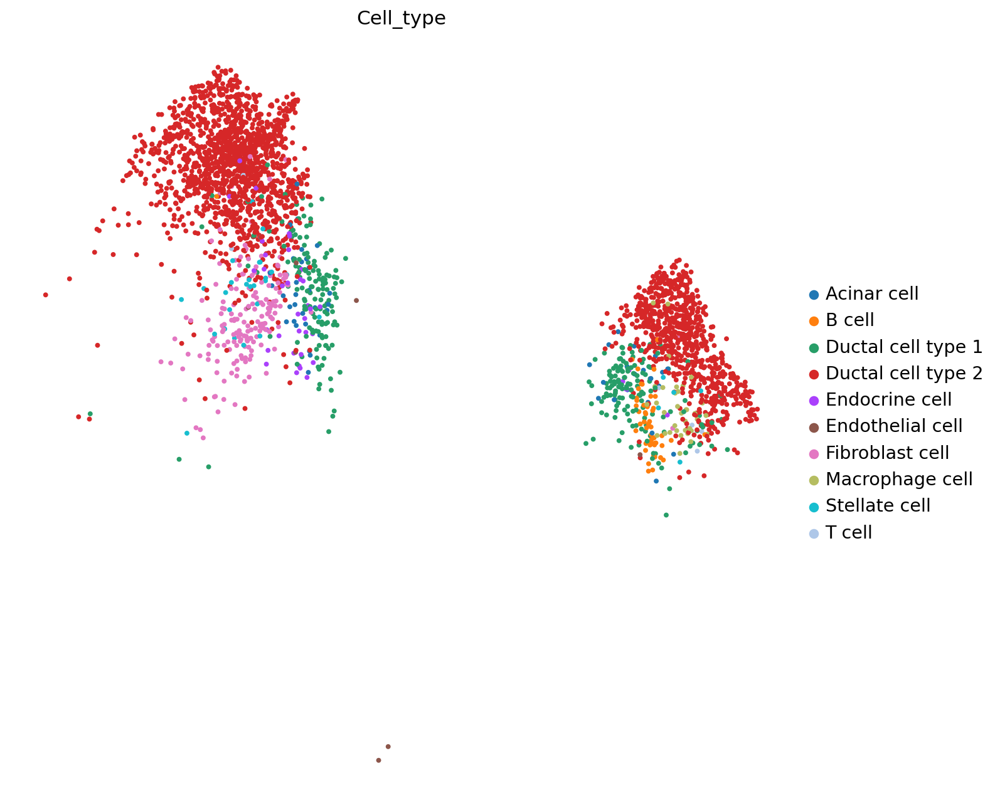

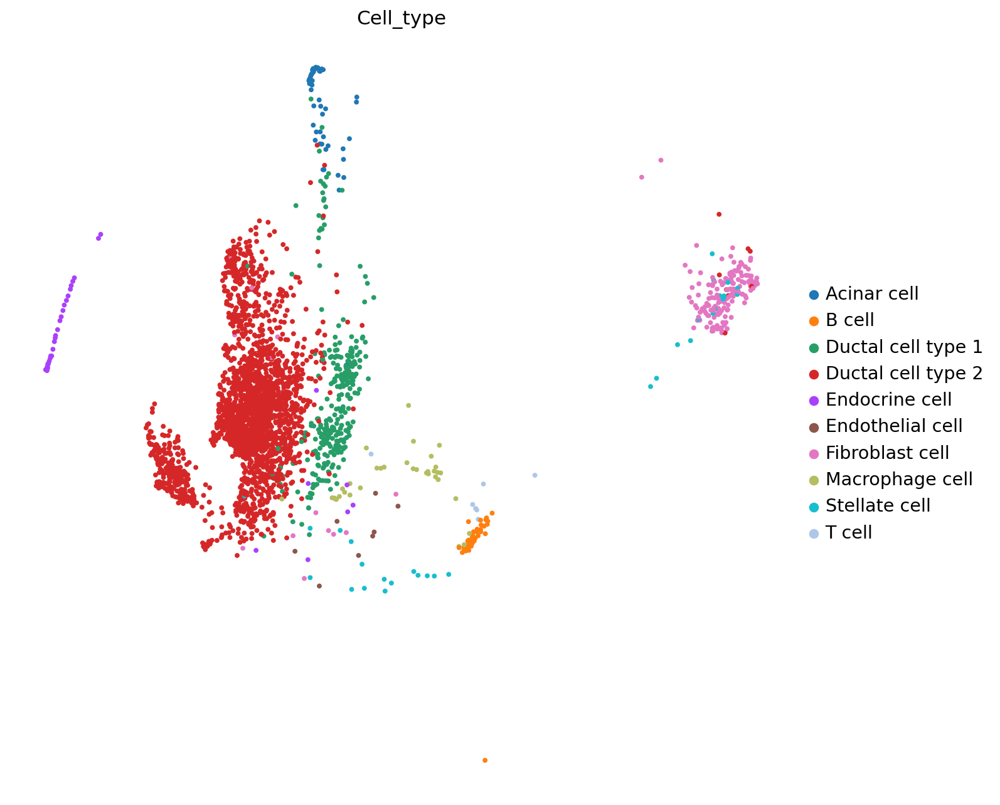

In [122]:
cnv.pl.umap(ref_subset[ref_subset.obs.cnv_leiden.isin(['9', '10'])], color='Cell_type', size=50)
sc.pl.umap(ref_subset[ref_subset.obs.cnv_leiden.isin(['9', '10'])], color='Cell_type',  size=50)

In [128]:
help(sc.pl.umap)

Help on function umap in module scanpy.plotting._tools.scatterplots:

umap(adata: anndata._core.anndata.AnnData, *, color: Union[str, Sequence[str], NoneType] = None, gene_symbols: Optional[str] = None, use_raw: Optional[bool] = None, sort_order: bool = True, edges: bool = False, edges_width: float = 0.1, edges_color: Union[str, Sequence[float], Sequence[str]] = 'grey', neighbors_key: Optional[str] = None, arrows: bool = False, arrows_kwds: Optional[Mapping[str, Any]] = None, groups: Optional[str] = None, components: Union[str, Sequence[str]] = None, dimensions: Union[Tuple[int, int], Sequence[Tuple[int, int]], NoneType] = None, layer: Optional[str] = None, projection: Literal['2d', '3d'] = '2d', scale_factor: Optional[float] = None, color_map: Union[matplotlib.colors.Colormap, str, NoneType] = None, cmap: Union[matplotlib.colors.Colormap, str, NoneType] = None, palette: Union[str, Sequence[str], cycler.Cycler, NoneType] = None, na_color: Union[str, Tuple[float, ...]] = 'lightgray', na

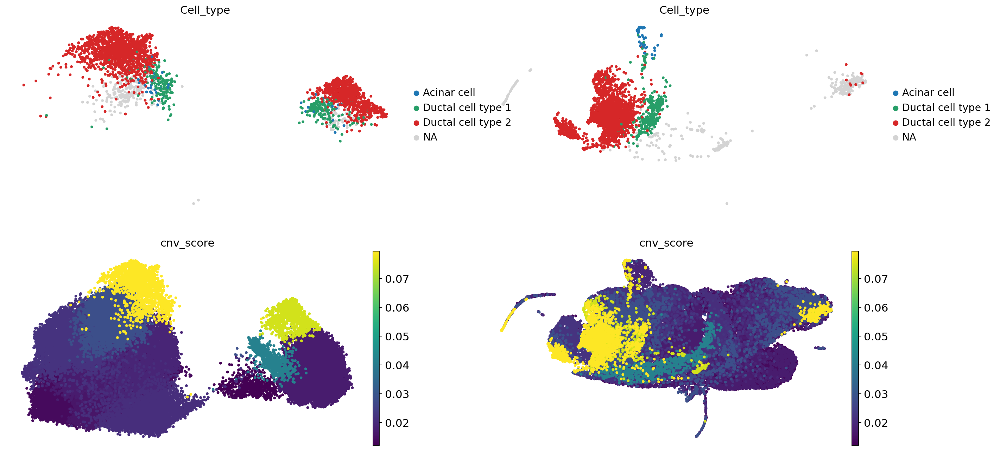

<Figure size 1600x800 with 0 Axes>

In [135]:
plt.rcParams['figure.figsize'] = [20, 10]
fig, ((ax1,ax2), (ax3, ax4)) = plt.subplots(2,2)
cnv.pl.umap(ref_subset[ref_subset.obs.cnv_leiden.isin(['9', '10'])], color='Cell_type', groups=malignant_cells, size=50, ax=ax1, show=False)
sc.pl.umap(ref_subset[ref_subset.obs.cnv_leiden.isin(['9', '10'])], color='Cell_type', groups=malignant_cells, size=50, ax=ax2, show=False)
cnv.pl.umap(ref_subset, color='cnv_score', groups=malignant_cells, size=50, ax=ax3, show=False)
sc.pl.umap(ref_subset, color='cnv_score', groups=malignant_cells, size=50, ax=ax4)
plt.tight_layout()
plt.show()

In [123]:
malignant_cells 

['Acinar cell', 'Ductal cell type 1', 'Ductal cell type 2']

In [145]:
condition = (
    ref_subset.obs['cnv_leiden'].isin(['9', '10']) &
    ref_subset.obs['Cell_type'].isin(malignant_cells)
)

ref_subset.obs['Malignant Classification'] = np.where(condition, 'Malignant', 'Non-Malignant')


... storing 'Malignant Classification' as categorical


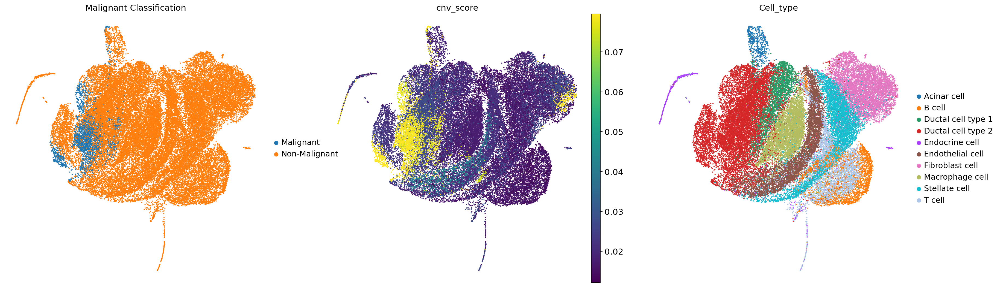

In [147]:
plt.rcParams['figure.figsize'] = [8,8]
random_indices = np.random.permutation(list(range(ref_subset.shape[0])))
sc.pl.umap(ref_subset[random_indices, :], color=['Malignant Classification', 'cnv_score', 'Cell_type'], size=15)   

In [149]:
peng.obs

,n_genes,ID,n_counts,log_counts,mt_frac,Dataset,sampleid,scrublet_scores,pid,n_genes_by_counts,...,exocrine_score_1,activated_stroma_score_1,histone_score_1,normal_stroma_score_1,olfactory_score_1,na_score_1,pseudo_barcode,scanvi_labels,Label_Harmonized,Reference
T1_AAACCTGAGATGTCGG,NaN,T1,NaN,NaN,NaN,Peng,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,annotated_cell_192045,Fibroblast,Fibroblast,Reference
T1_AAACGGGGTCATGCAT,NaN,T1,NaN,NaN,NaN,Peng,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,annotated_cell_192046,Stellate Cell,Stellate Cell,Reference
T1_AAAGATGCATGTTGAC,NaN,T1,NaN,NaN,NaN,Peng,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,annotated_cell_192047,Macrophage,Macrophage,Reference
T1_AAAGATGGTCGAGTTT,NaN,T1,NaN,NaN,NaN,Peng,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,annotated_cell_192048,Macrophage,Macrophage,Reference
T1_AAAGATGGTCTCTCTG,NaN,T1,NaN,NaN,NaN,Peng,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,annotated_cell_192049,Endothelial Cell,Endothelial Cell,Reference
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
T24_TTTGGTTGTGTTGAGG,NaN,T24,NaN,NaN,NaN,Peng,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,annotated_cell_234004,Stellate Cell,Stellate Cell,Reference
T24_TTTGGTTTCCAGAGGA,NaN,T24,NaN,NaN,NaN,Peng,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,annotated_cell_234005,Stellate Cell,Stellate Cell,Reference
T24_TTTGGTTTCCTGCTTG,NaN,T24,NaN,NaN,NaN,Peng,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,annotated_cell_234006,Ductal Cell,Ductal Cell,Potentially Malignant
T24_TTTGTCAAGATGTCGG,NaN,T24,NaN,NaN,NaN,Peng,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,annotated_cell_234007,Ductal Cell,Ductal Cell,Potentially Malignant


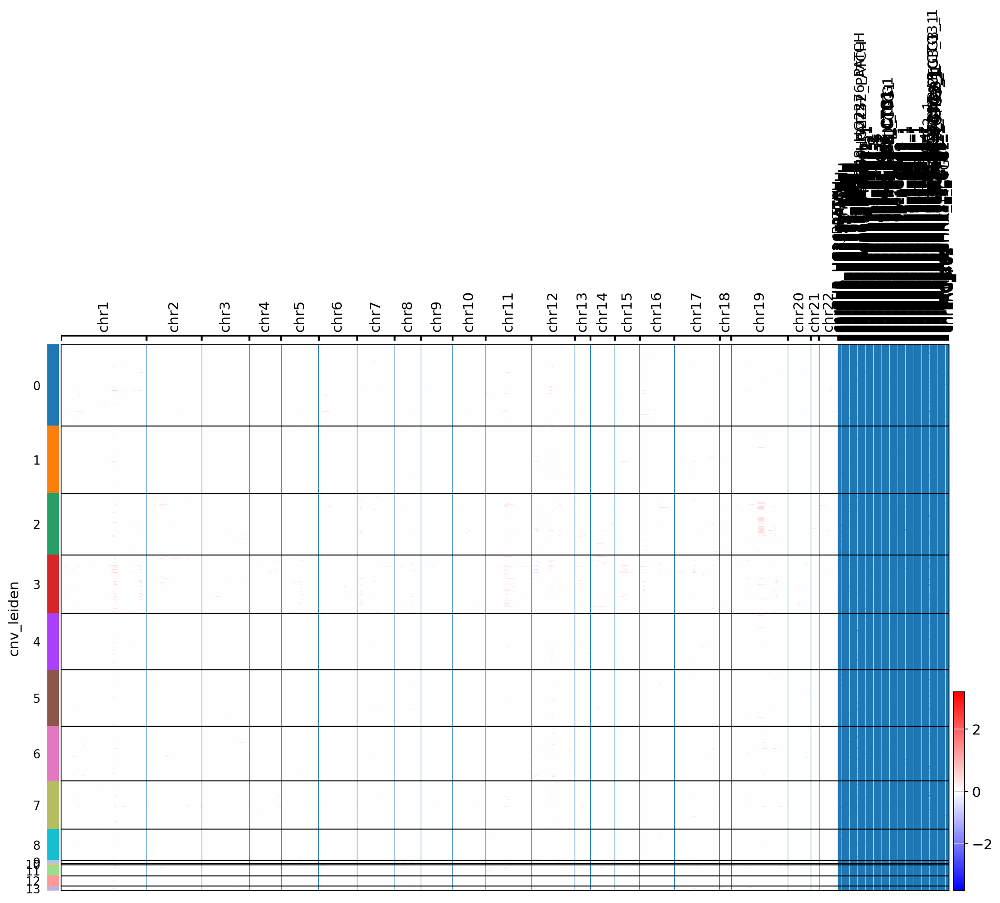

In [159]:
cnv.pl.chromosome_heatmap(ref_subset[ref_subset.obs["Malignant Classification"] == "Non-Malignant", :])

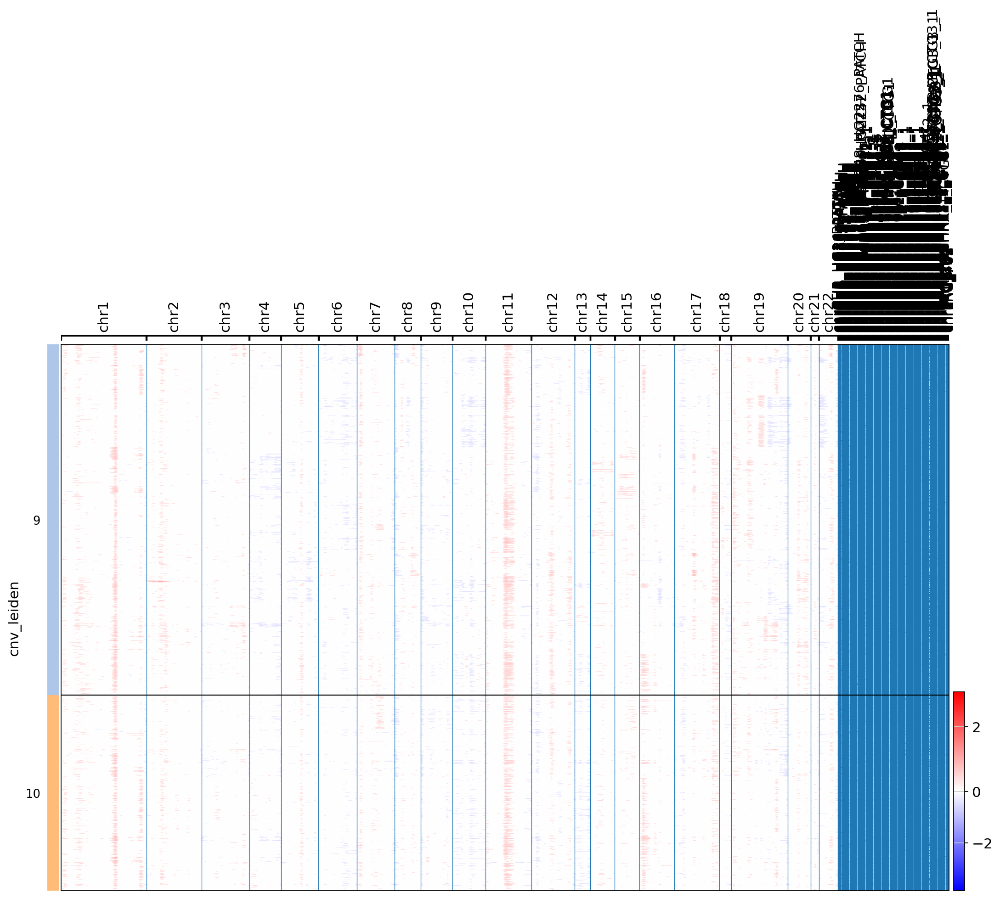

In [158]:
cnv.pl.chromosome_heatmap(ref_subset[ref_subset.obs["Malignant Classification"] == "Malignant", :])

In [152]:
ref_subset.write('/home/aih/shrey.parikh/PDAC/PDAC/inferCNV/Peng/PDAC_Peng_inferCNV.h5ad')

... storing 'Malignant Classification' as categorical


# successful completion for PENG

## Zenodo

In [4]:
zenodo = sc.read_h5ad('/home/aih/shrey.parikh/PDAC/PDAC/processed_datasets/All_genes/zenodo_PDAC_new.h5ad')

In [ ]:
ensdb = gf.ensembl.annotation(species="Hsapiens", version="108")
genes = ensdb.genes()
dict_map = {gene: (start, end, chrom) for gene, start, end, chrom in zip(genes.gene_name, genes.gene_seq_start, genes.gene_seq_end, genes.seq_name)}

In [9]:
zenodo.obs.Cell_type.unique().tolist()

['Ductal cell type 2',
 'Ductal cell type 1',
 'Macrophage cell',
 'Endocrine cell',
 'Endothelial cell',
 'T cell',
 'Fibroblast cell',
 'Acinar cell',
 'Stellate cell',
 'B cell']

infering CNVs


  0%|          | 0/4 [00:00<?, ?it/s]

... storing 'Reference' as categorical


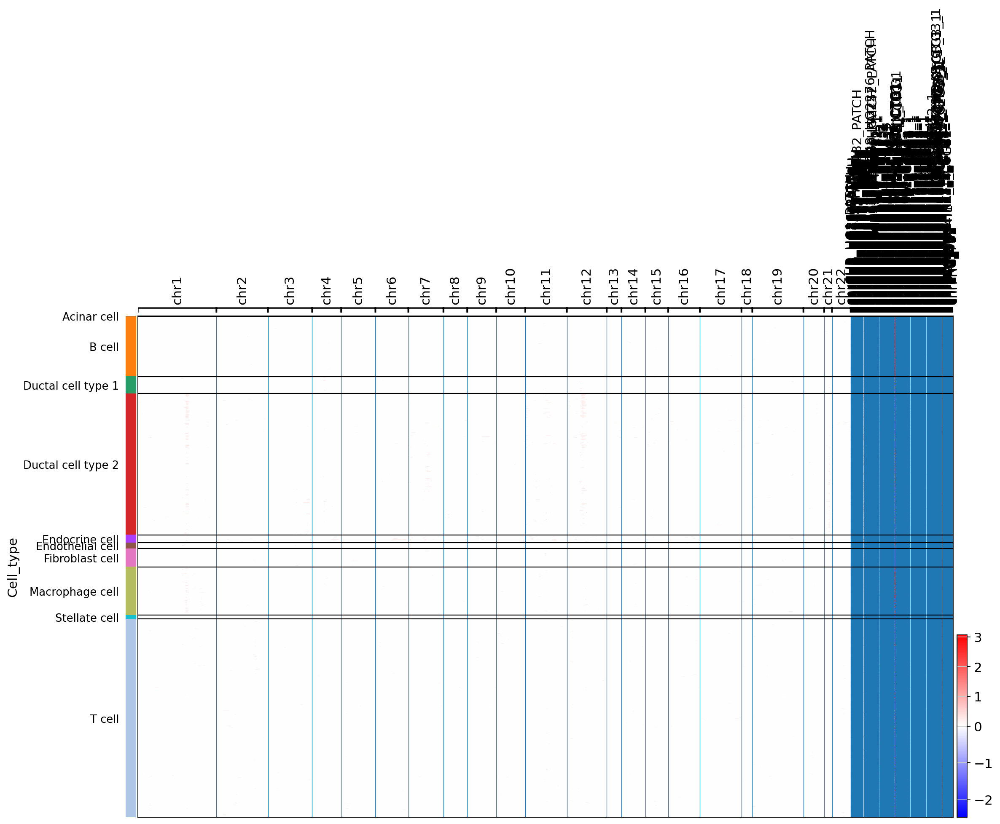

... storing 'Reference' as categorical


         Falling back to preprocessing with `sc.pp.pca` and default params.
categories: 0, 1, 2, etc.
var_group_labels: chr1, chr2, chr3, etc.


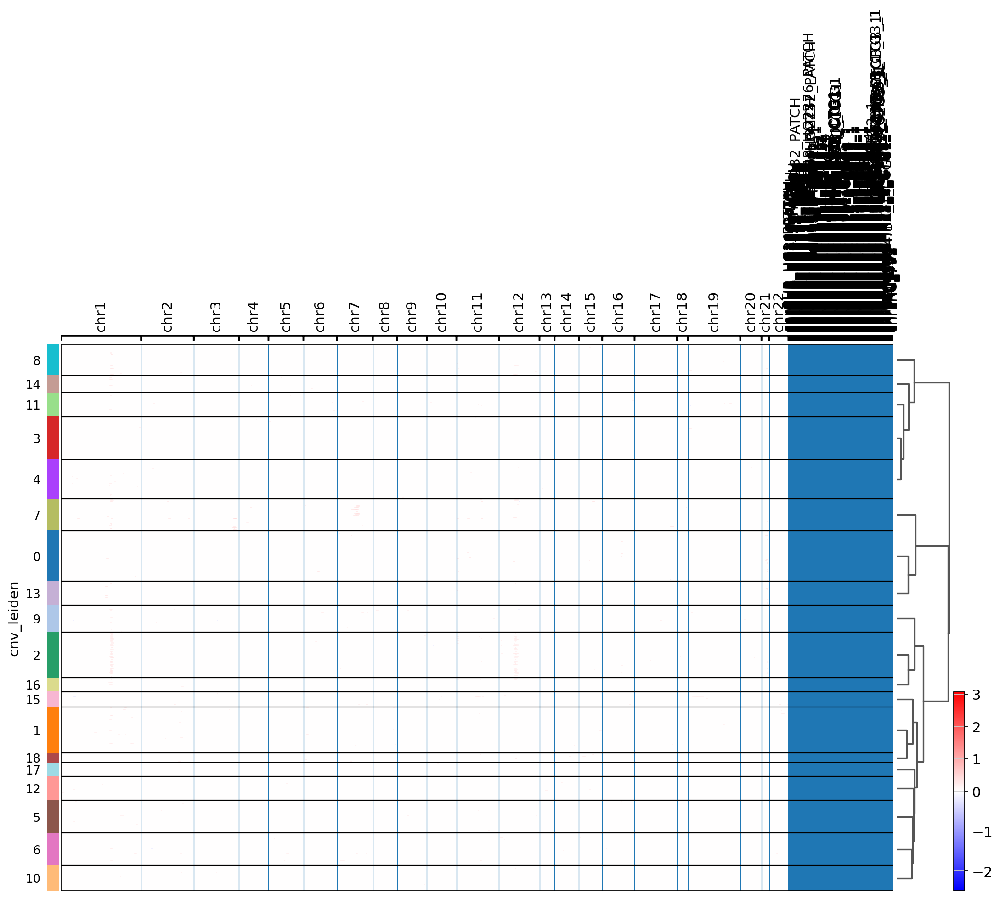

In [10]:
ref_subset = zenodo.copy()
sc.pp.filter_genes(ref_subset, min_cells=5)
ref_subset.var['start'] = ref_subset.var.index.map(lambda x: dict_map[x][0] if x in dict_map else None)
ref_subset.var['end'] = ref_subset.var.index.map(lambda x: dict_map[x][1] if x in dict_map else None)
ref_subset.var['chromosome'] = ref_subset.var.index.map(lambda x: dict_map[x][2] if x in dict_map else None)
ref_subset.var['chromosome'] = 'chr' + ref_subset.var['chromosome']


malignant_cells = ["Acinar cell", "Ductal cell type 1", "Ductal cell type 2"]
ref_subset.obs["Reference"] = np.where(ref_subset.obs.Cell_type.isin(malignant_cells), 'Potentially Malignant', 'Reference')
#     # Normalize, log transform, and perform dimensionality reduction
# sc.pp.normalize_total(ref_subset, target_sum=1e4)
# sc.pp.log1p(ref_subset)
sc.pp.neighbors(ref_subset)
sc.tl.umap(ref_subset)
sc.tl.leiden(ref_subset)
print(f'infering CNVs')
#     # Run inferCNV
cnv.tl.infercnv(
    ref_subset,
    reference_key="Reference",
    reference_cat="Reference",
    window_size=150,
)

#     # PCA and neighbor graph for CNV data
cnv.tl.pca(ref_subset)
cnv.pp.neighbors(ref_subset)
cnv.tl.leiden(ref_subset)

#     # Run UMAP and CNV scoring
cnv.tl.umap(ref_subset)
cnv.tl.cnv_score(ref_subset)

#     # Save results
# output_dir = f"inferCNV/{dataset}"
# os.makedirs(output_dir, exist_ok=True)
# ref_subset.write(f"{output_dir}/PDAC_{dataset}_inferCNV.h5ad")
# print('Saving Images')
#     # Save chromosome heatmap
cnv.pl.chromosome_heatmap(ref_subset, groupby="Cell_type")
cnv.pl.chromosome_heatmap(ref_subset, groupby="cnv_leiden", dendrogram=True)


In [175]:
# sc.pp.neighbors(zenodo)
# sc.tl.umap(zenodo)

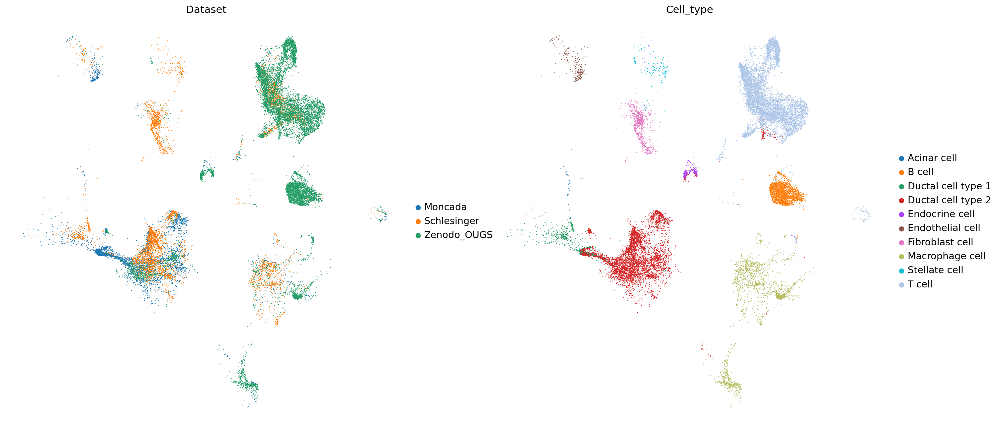

In [8]:
plt.rcParams['figure.figsize'] = [10, 10]   
sc.pl.umap(zenodo, color=['Dataset', 'Cell_type'], size=5)

... storing 'Reference' as categorical
... storing 'chromosome' as categorical
... storing 'Reference' as categorical
... storing 'chromosome' as categorical
... storing 'Reference' as categorical
... storing 'chromosome' as categorical


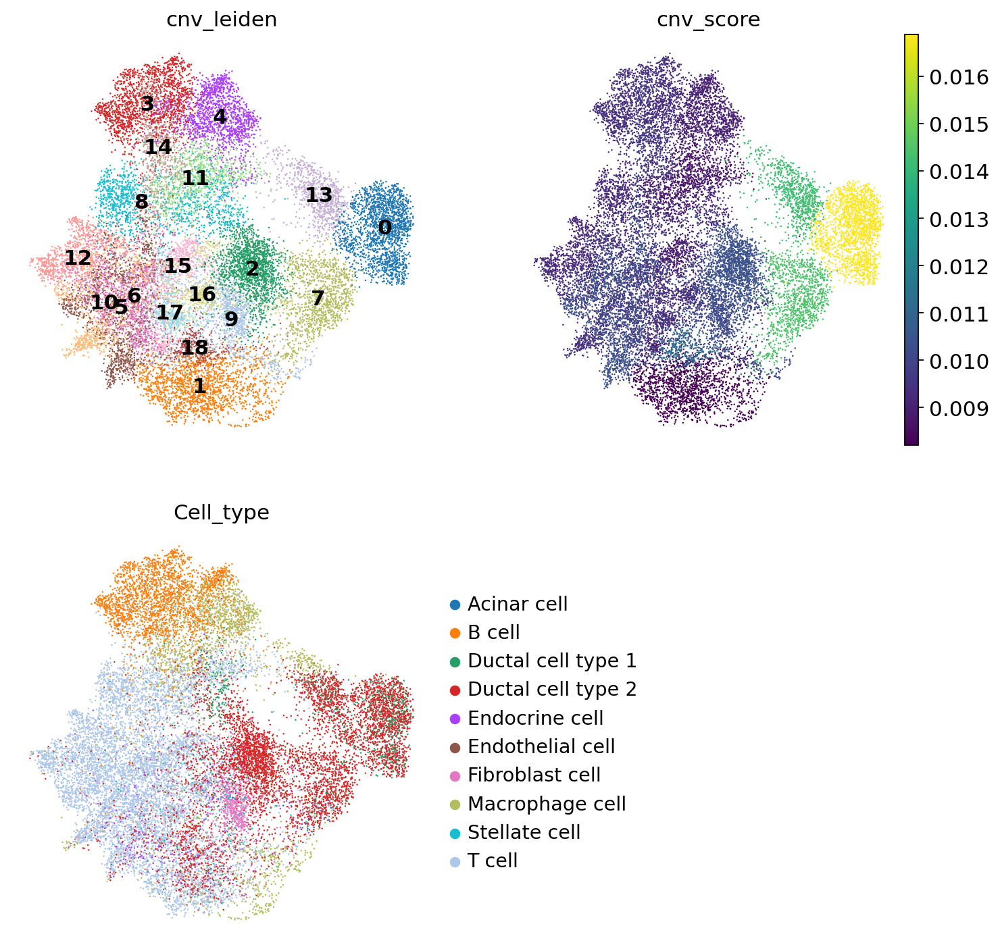

... storing 'Reference' as categorical
... storing 'chromosome' as categorical
... storing 'Reference' as categorical
... storing 'chromosome' as categorical
... storing 'Reference' as categorical
... storing 'chromosome' as categorical


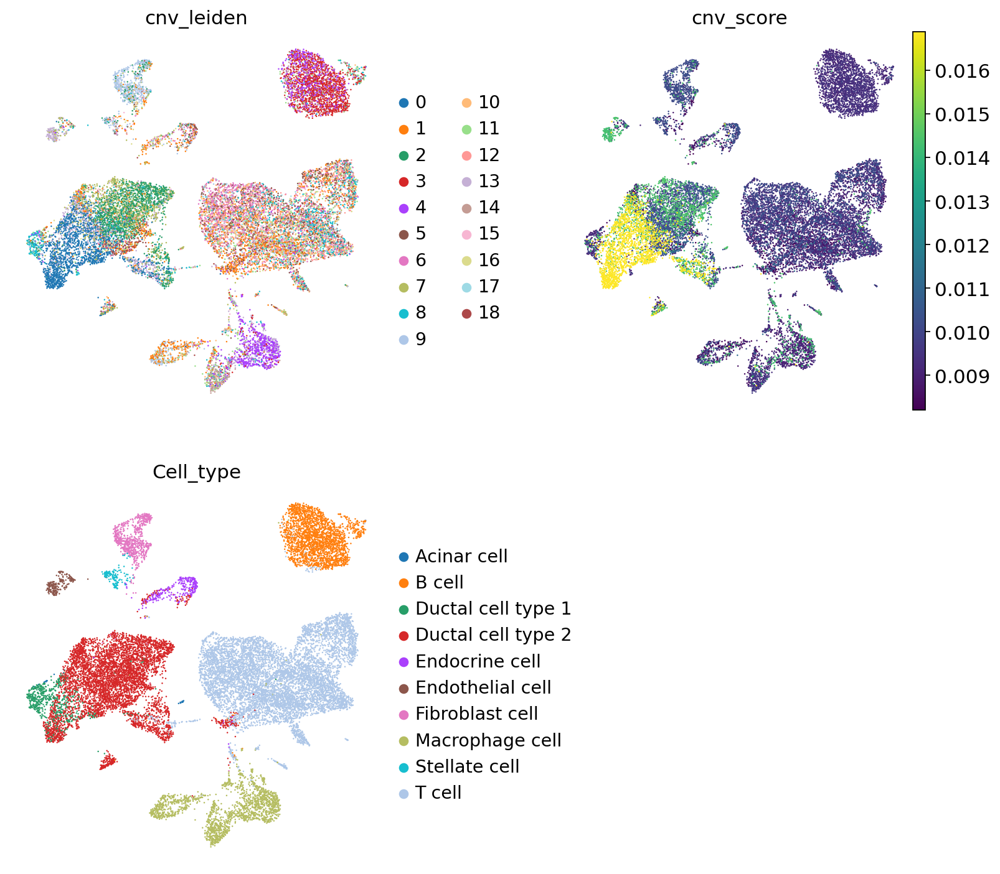

Completed inferring CNVs


In [13]:

#     # Save combined UMAP plots
try:
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(11, 11))
    ax4.axis("off")
    np.random.seed(0)
    random_indices = np.random.permutation(range(ref_subset.shape[0]))
    cnv.pl.umap(ref_subset[random_indices,:], color="cnv_leiden", ax=ax1, legend_loc="on data", show=False, size=5)
    cnv.pl.umap(ref_subset[random_indices,:], color="cnv_score", ax=ax2, show=False, size=5)
    cnv.pl.umap(ref_subset[random_indices,:], color="Cell_type", ax=ax3, size=5)
    plt.close(fig) 
    # fig.savefig(f"{dataset}_combined_umap.png")
except Exception as e:
    print(f"An error occurred while saving UMAP plots for {e}")

fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(12, 11), gridspec_kw={"wspace": 0.5})
ax4.axis("off")
np.random.seed(0)
random_indices = np.random.permutation(list(range(ref_subset.shape[0])))
sc.pl.umap(ref_subset[random_indices,:], color="cnv_leiden", ax=ax1, show=False, size=5)
sc.pl.umap(ref_subset[random_indices,:], color="cnv_score", ax=ax2, show=False, size=5)
sc.pl.umap(ref_subset[random_indices,:], color="Cell_type", ax=ax3, size=5)
# fig.savefig(f"inferCNV/{dataset}_combined_umap_transcriptomic.png")
print(f'Completed inferring CNVs')

In [14]:
ref_subset[ref_subset.obs.cnv_leiden.isin(['0', '7', '13'])].obs.Cell_type.unique().tolist()

['Ductal cell type 2',
 'Ductal cell type 1',
 'Macrophage cell',
 'Endocrine cell',
 'Endothelial cell',
 'T cell',
 'Fibroblast cell',
 'Acinar cell',
 'Stellate cell',
 'B cell']

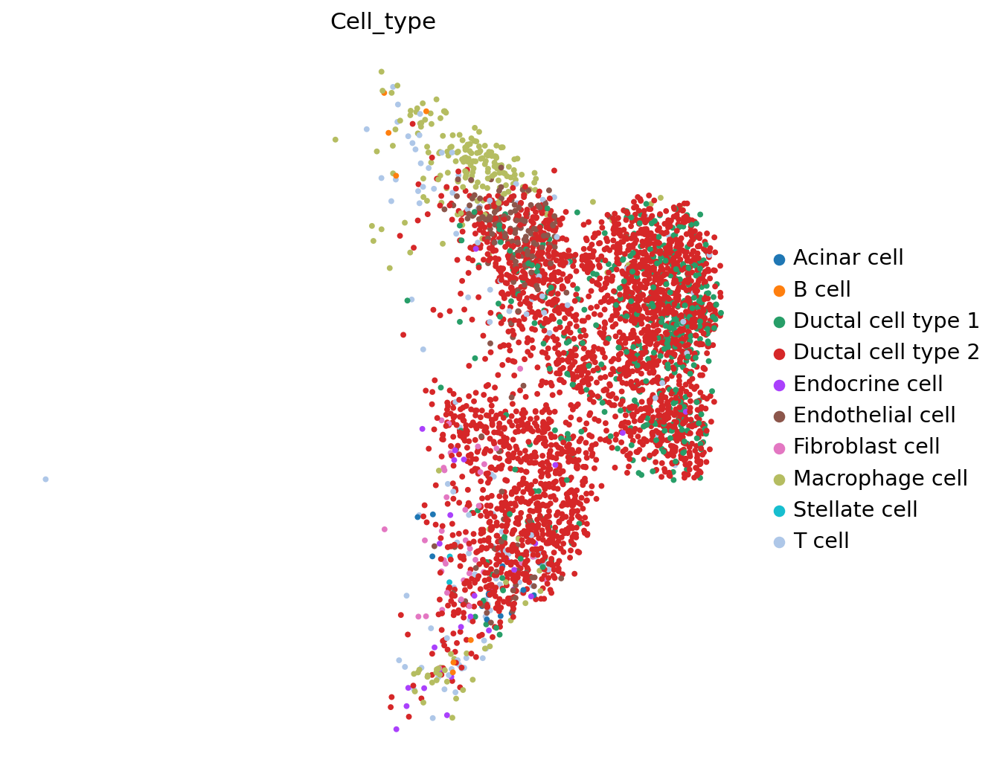

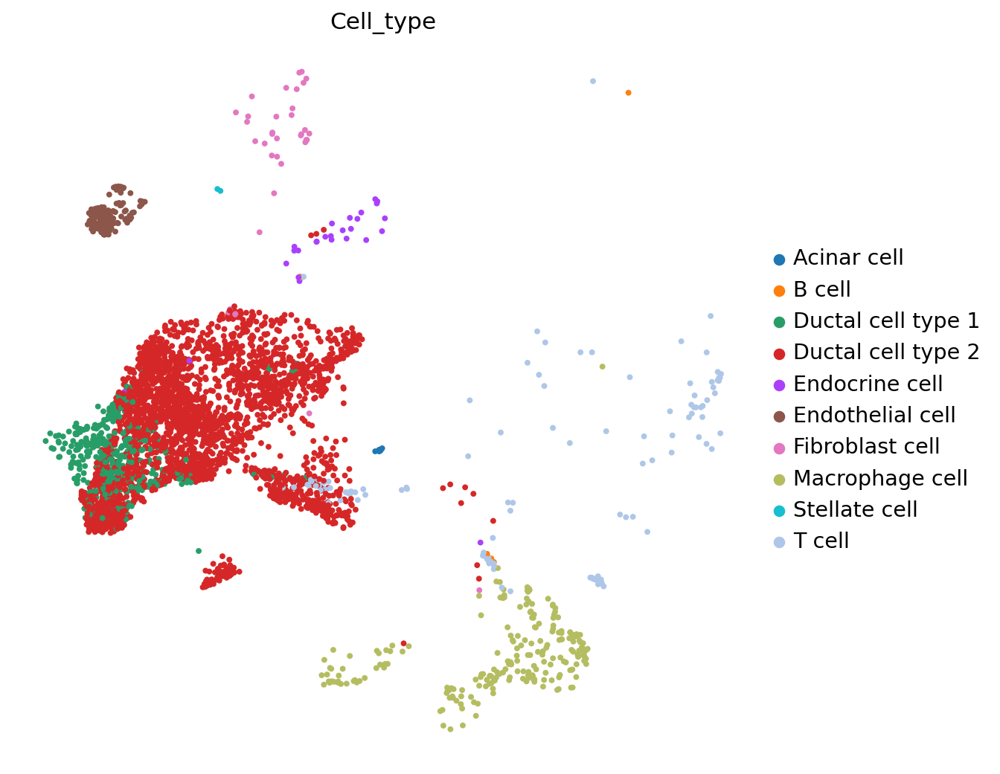

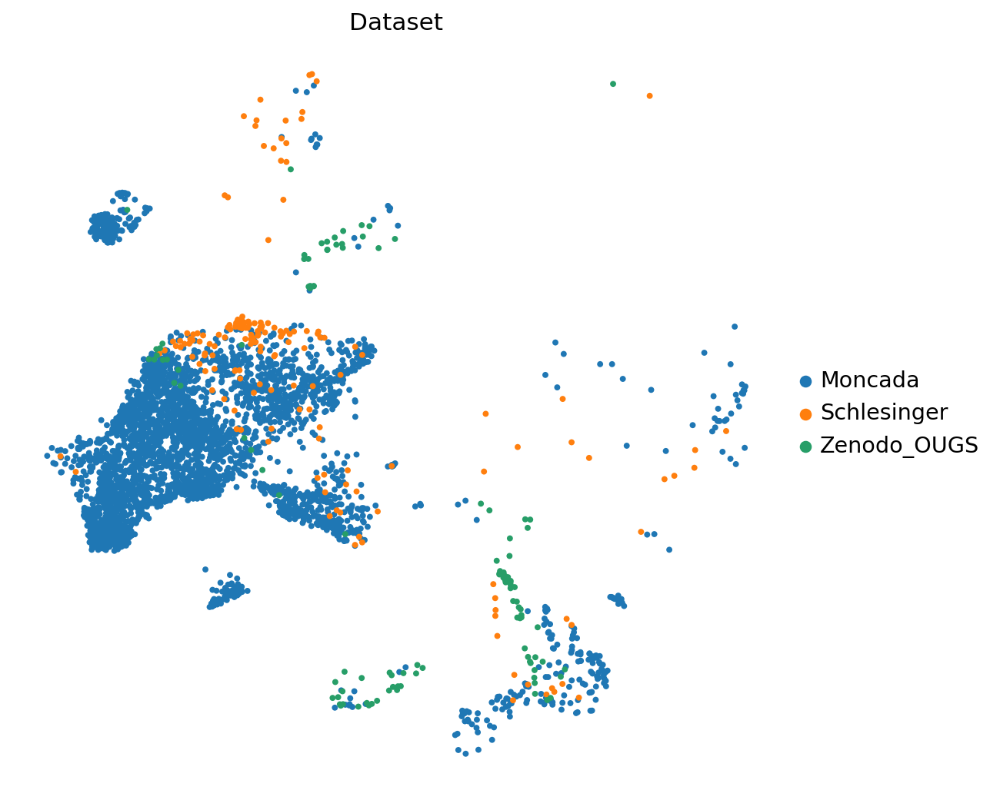

In [24]:
cnv.pl.umap(ref_subset[ref_subset.obs.cnv_leiden.isin(['0', '7', '13'])], color='Cell_type', size=50)
sc.pl.umap(ref_subset[ref_subset.obs.cnv_leiden.isin(['0', '7', '13'])], color='Cell_type',  size=50)
sc.pl.umap(ref_subset[ref_subset.obs.cnv_leiden.isin(['0', '7', '13'])], color='Dataset',  size=50)

... storing 'Reference' as categorical
... storing 'chromosome' as categorical
... storing 'Reference' as categorical
... storing 'chromosome' as categorical
... storing 'Reference' as categorical
... storing 'chromosome' as categorical


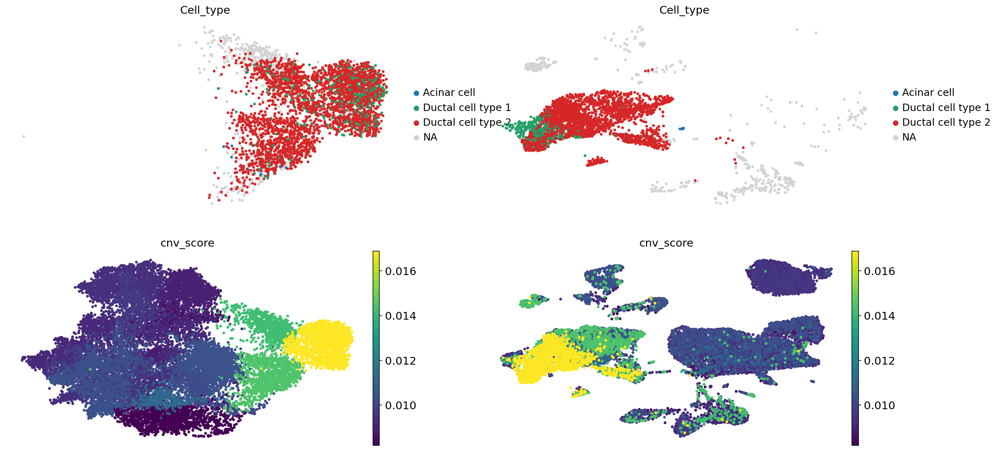

<Figure size 1600x800 with 0 Axes>

In [16]:
plt.rcParams['figure.figsize'] = [20, 10]
fig, ((ax1,ax2), (ax3, ax4)) = plt.subplots(2,2)
cnv.pl.umap(ref_subset[ref_subset.obs.cnv_leiden.isin(['0', '7', '13'])], color='Cell_type', groups=malignant_cells, size=50, ax=ax1, show=False)
sc.pl.umap(ref_subset[ref_subset.obs.cnv_leiden.isin(['0', '7', '13'])], color='Cell_type', groups=malignant_cells, size=50, ax=ax2, show=False)
cnv.pl.umap(ref_subset, color='cnv_score', groups=malignant_cells, size=50, ax=ax3, show=False)
sc.pl.umap(ref_subset, color='cnv_score', groups=malignant_cells, size=50, ax=ax4)
plt.tight_layout()
plt.show()

In [ ]:
malignant_cells 

['Acinar cell', 'Ductal cell type 1', 'Ductal cell type 2']

In [17]:
condition = (
    ref_subset.obs['cnv_leiden'].isin(['0', '7', '13']) &
    ref_subset.obs['Cell_type'].isin(malignant_cells)
)

ref_subset.obs['Malignant Classification'] = np.where(condition, 'Malignant', 'Non-Malignant')


... storing 'Malignant Classification' as categorical


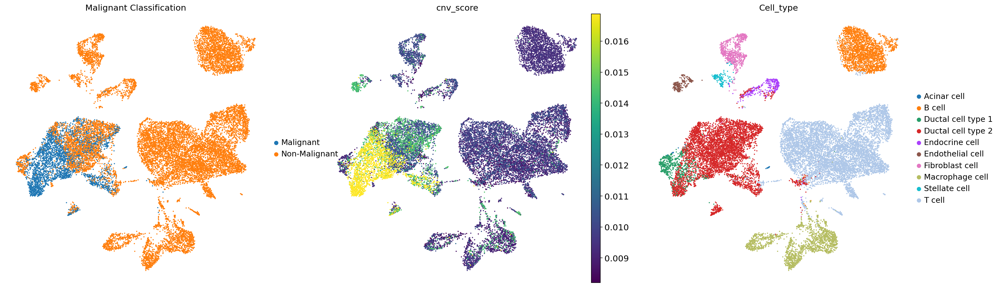

In [18]:
plt.rcParams['figure.figsize'] = [8,8]
random_indices = np.random.permutation(list(range(ref_subset.shape[0])))
sc.pl.umap(ref_subset[random_indices, :], color=['Malignant Classification', 'cnv_score', 'Cell_type'], size=15)   

In [20]:
ref_subset.obs

,CELL,Patient,Type,Cell_type,celltype0,celltype1,celltype2,celltype3,Patient2,nCount_RNA,...,normal_stroma_score_1,olfactory_score_1,na_score_1,Dataset,ID,Reference,leiden,cnv_leiden,cnv_score,Malignant Classification
GSE111672_PDAC_A_Ductal...terminal.ductal.like.1,NaN,GSE111672_PDAC_A,Tumor,Ductal cell type 2,NaN,NaN,NaN,NaN,GSE111672_A,11486.0,...,-0.056915,0.236435,0.034488,Moncada,GSE111672_PDAC_A,Potentially Malignant,13,0,0.016877,Malignant
GSE111672_PDAC_A_Cancer.clone.A,NaN,GSE111672_PDAC_A,Tumor,Ductal cell type 2,NaN,NaN,NaN,NaN,GSE111672_A,10632.0,...,-0.040060,-0.016441,0.017244,Moncada,GSE111672_PDAC_A,Potentially Malignant,1,7,0.014459,Malignant
GSE111672_PDAC_A_Cancer.clone.A.1,NaN,GSE111672_PDAC_A,Tumor,Ductal cell type 2,NaN,NaN,NaN,NaN,GSE111672_A,10309.0,...,-0.045146,-0.084451,0.006001,Moncada,GSE111672_PDAC_A,Potentially Malignant,1,7,0.014459,Malignant
GSE111672_PDAC_A_Ductal...CRISP3.high.centroacinar.like.1,NaN,GSE111672_PDAC_A,Tumor,Ductal cell type 2,NaN,NaN,NaN,NaN,GSE111672_A,9712.0,...,-0.024975,0.678296,0.043422,Moncada,GSE111672_PDAC_A,Potentially Malignant,7,0,0.016877,Malignant
GSE111672_PDAC_A_Ductal...terminal.ductal.like.2,NaN,GSE111672_PDAC_A,Tumor,Ductal cell type 2,NaN,NaN,NaN,NaN,GSE111672_A,8321.0,...,-0.047356,0.338277,0.094539,Moncada,GSE111672_PDAC_A,Potentially Malignant,7,0,0.016877,Malignant
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
pk210318_TTTGGTTTCCGATCTC-1,NaN,pk210318,Tumor,Macrophage cell,NaN,NaN,NaN,NaN,OUGS_T4,1740.0,...,-0.005438,-0.001765,-0.013295,Zenodo_OUGS,pk210318,Reference,16,1,0.008202,Non-Malignant
pk210318_TTTGGTTTCCTTCACG-1,NaN,pk210318,Tumor,Macrophage cell,NaN,NaN,NaN,NaN,OUGS_T4,1177.0,...,0.011655,0.006083,-0.010507,Zenodo_OUGS,pk210318,Reference,16,1,0.008202,Non-Malignant
pk210318_TTTGTTGCAATGCAAA-1,NaN,pk210318,Tumor,T cell,NaN,NaN,NaN,NaN,OUGS_T4,5833.0,...,-0.030641,-0.048538,-0.018958,Zenodo_OUGS,pk210318,Reference,12,12,0.009162,Non-Malignant
pk210318_TTTGTTGGTATGAGCG-1,NaN,pk210318,Tumor,T cell,NaN,NaN,NaN,NaN,OUGS_T4,4695.0,...,-0.024168,-0.042796,0.002950,Zenodo_OUGS,pk210318,Reference,5,3,0.009361,Non-Malignant


... storing 'Malignant Classification' as categorical


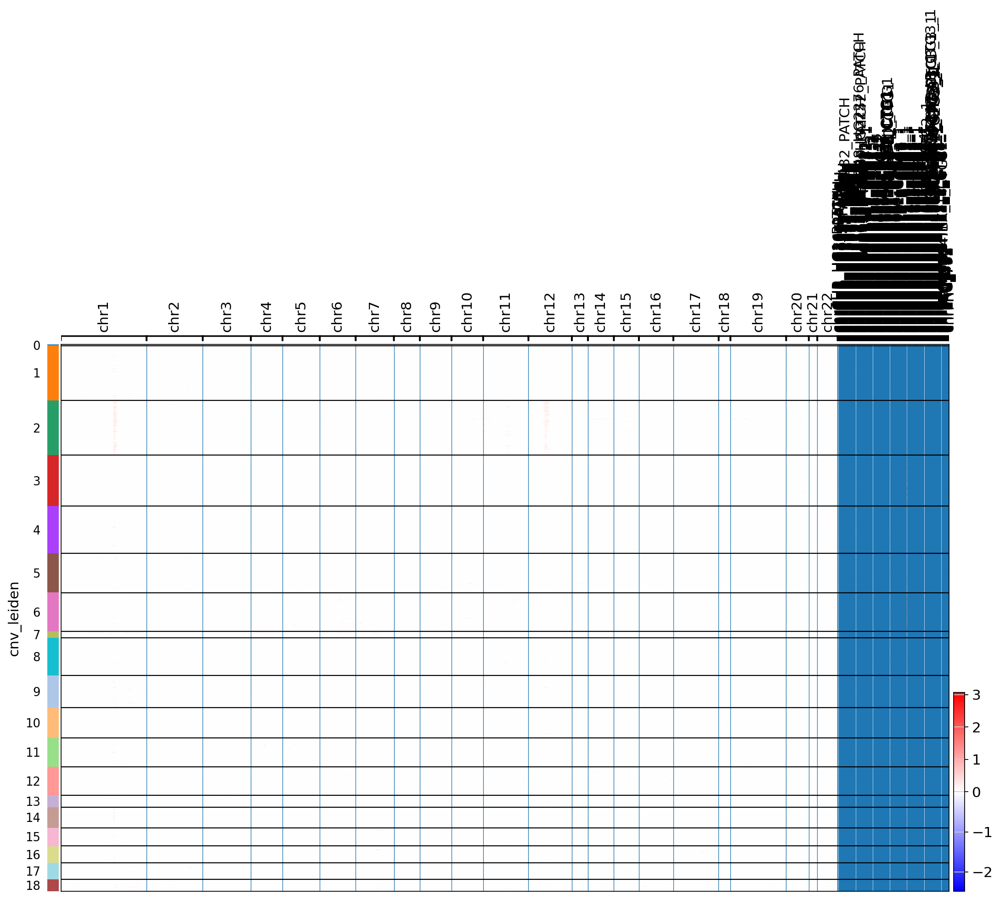

In [21]:
cnv.pl.chromosome_heatmap(ref_subset[ref_subset.obs["Malignant Classification"] == "Non-Malignant", :])

... storing 'Malignant Classification' as categorical


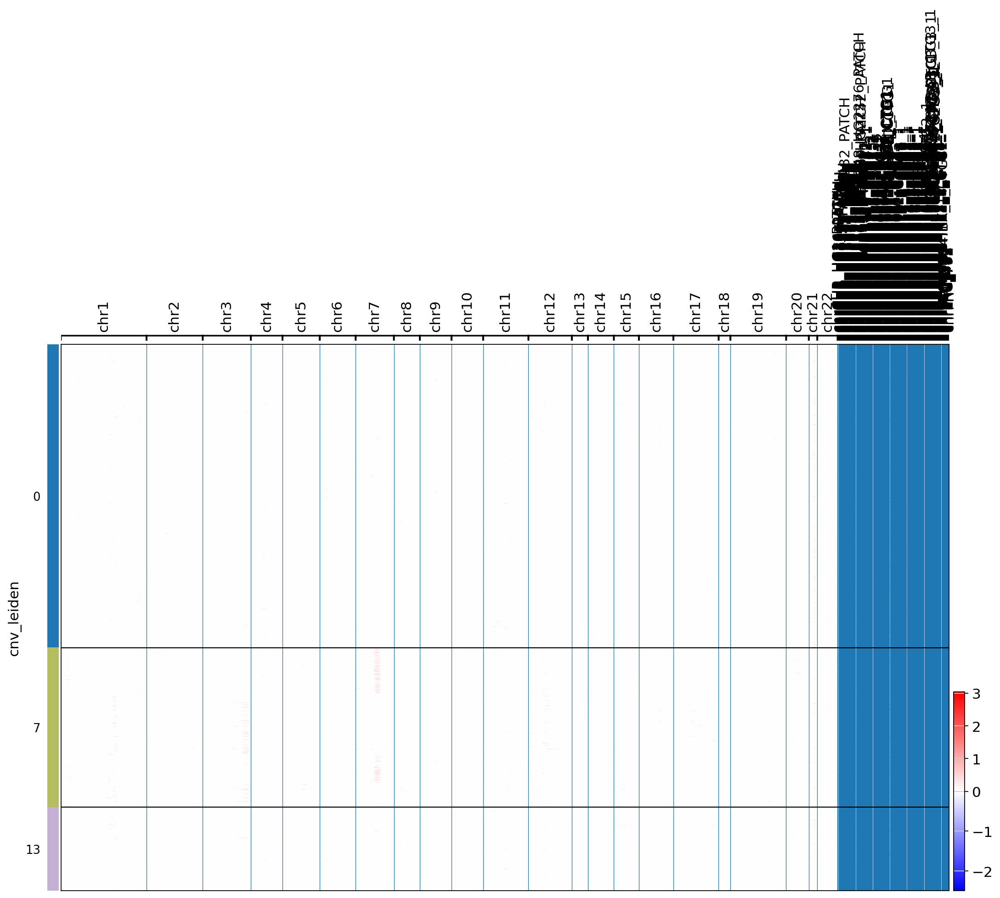

In [22]:
cnv.pl.chromosome_heatmap(ref_subset[ref_subset.obs["Malignant Classification"] == "Malignant", :])

In [23]:
ref_subset.write('/home/aih/shrey.parikh/PDAC/PDAC/inferCNV/Zenodo_OUGS/PDAC_Zenodo_OUGS_inferCNV.h5ad')

... storing 'Malignant Classification' as categorical


In [ ]:
ref